                                                                                      This notebook will include my thought processes which will be Italicized
                                                                                      
# Individual household electric power consumption dataset from UCI
## I will explore the data to see if we can infer any trends before we start cleaning the data


Data Set Information:

Data acquired from UCI Machine Learning Repository: https://archive.ics.uci.edu/ml/datasets/Individual+household+electric+power+consumption

This archive contains 2075259 measurements gathered in a house located in Sceaux (7km of Paris, France) between December 2006 and November 2010 (47 months).\
Notes:

1.(global_active_power*1000/60 - sub_metering_1 - sub_metering_2 - sub_metering_3) represents the active energy consumed every minute (in watt hour) in the household by electrical equipment not measured in sub-meterings 1, 2 and 3.

2.The dataset contains some missing values in the measurements (nearly 1,25% of the rows). All calendar timestamps are present\ in the dataset but for some timestamps, the measurement values are missing: a missing value is represented by the absence of\ value between two consecutive semi-colon attribute separators. For instance, the dataset shows missing values on April 28, 2007.



Attribute Information:

1. date: Date in format dd/mm/yyyy
2. time: time in format hh:mm:ss
3. global_active_power: household global minute-averaged active power (in kilowatt)
4. global_reactive_power: household global minute-averaged reactive power (in kilowatt)
5. voltage: minute-averaged voltage (in volt)
6. global_intensity: household global minute-averaged current intensity (in ampere)
7. sub_metering_1: energy sub-metering No. 1 (in watt-hour of active energy). It corresponds to the kitchen, containing mainly a dishwasher, an oven and a microwave (hot plates are not electric but gas powered).
8. sub_metering_2: energy sub-metering No. 2 (in watt-hour of active energy). It corresponds to the laundry room, containing a washing-machine, a tumble-drier, a refrigerator and a light.
9. sub_metering_3: energy sub-metering No. 3 (in watt-hour of active energy). It corresponds to an electric water-heater and an air-conditioner.

## _Initial thoughts, this is a very standard time-series data, we can do a lot of graphs such as :_
 - Dependence on active vs reactive power to see which is dominant.
 - Power dependence from each sub metering to show which components typically use more. 
 - How much power is consumed by non-measured utilities.

In [59]:
# imports
from warnings import simplefilter

simplefilter(action="ignore", category=FutureWarning)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
from sklearn import metrics
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess
from tensorflow import keras
from tensorflow.keras import layers, metrics
from matplotlib.offsetbox import AnchoredText
from statsmodels.graphics.tsaplots import plot_pacf

sns.color_palette("bright")
# Set Matplotlib defaults, ggplot is nice!
plt.style.use("ggplot")
plt.rc("figure", autolayout=True, figsize=(15, 8))
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=16,
    titlepad=10,
)
plot_params = dict(
    color="0.75",
    style=".-",
    markeredgecolor="0.25",
    markerfacecolor="0.25",
    legend=False,
)
%config InlineBackend.figure_format = 'retina'

<br><br>
***
<br><br>

### Loading Data

In [3]:
df = pd.read_csv(
    "household_power_consumption.txt",
    sep=";",
    infer_datetime_format=True,
    low_memory=False,
    na_values=["nan", "?"],
    parse_dates={"dt": ["Date", "Time"]},
    index_col="dt",
    dtype={
        "Global_active_power": "float32",  # use float32 to usee less bytes! Faster proccessing
        "Global_reactive_power": "float32",
        "Voltage": "float32",
        "Global_intensity": "float32",
        "Sub_metering_1": "float32",
        "Sub_metering_2": "float32",
        "Sub_metering_3": "float32",
    },
)
df.head()

,Global_active_power,Global_reactive_power,Voltage,Global_intensity,Sub_metering_1,Sub_metering_2,Sub_metering_3
dt,,,,,,,
2006-12-16 17:24:00,4.216,0.418,234.839996,18.4,0.0,1.0,17.0
2006-12-16 17:25:00,5.360,0.436,233.630005,23.0,0.0,1.0,16.0
2006-12-16 17:26:00,5.374,0.498,233.289993,23.0,0.0,2.0,17.0
2006-12-16 17:27:00,5.388,0.502,233.740005,23.0,0.0,1.0,17.0
2006-12-16 17:28:00,3.666,0.528,235.679993,15.8,0.0,1.0,17.0


Adding column of Active energy consumed every minute by unmeasured electrical equipment.

Unmeasured = (global_active_power*1000/60 - sub_metering_1 - sub_metering_2 - sub_metering_3)


In [4]:
df["Unmeasured"] = (
    (df.Global_active_power * 1000 / 60)
    - df.Sub_metering_1
    - df.Sub_metering_2
    - df.Sub_metering_3
)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2075259 entries, 2006-12-16 17:24:00 to 2010-11-26 21:02:00
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   Global_active_power    float32
 1   Global_reactive_power  float32
 2   Voltage                float32
 3   Global_intensity       float32
 4   Sub_metering_1         float32
 5   Sub_metering_2         float32
 6   Sub_metering_3         float32
 7   Unmeasured             float32
dtypes: float32(8)
memory usage: 79.2 MB


<br><br>
***
<br><br>

# Data Profiling / EDA / Cleaning
Lets see if there are missing values 

In [5]:
df.isnull().sum()

Global_active_power      25979
Global_reactive_power    25979
Voltage                  25979
Global_intensity         25979
Sub_metering_1           25979
Sub_metering_2           25979
Sub_metering_3           25979
Unmeasured               25979
dtype: int64

That's about 1.25% of our data\
Let's explore:
- how many rows they inhibit  
- if there are more outliers

In [5]:
df_nans = df[df.isna().any(axis=1)]
df_nans.head()

,Global_active_power,Global_reactive_power,Voltage,Global_intensity,Sub_metering_1,Sub_metering_2,Sub_metering_3,Unmeasured
dt,,,,,,,,
2006-12-21 11:23:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-12-21 11:24:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-12-30 10:08:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-12-30 10:09:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2007-01-14 18:36:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
df_nans.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 25979 entries, 2006-12-21 11:23:00 to 2010-10-24 15:35:00
Data columns (total 8 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Global_active_power    0 non-null      float32
 1   Global_reactive_power  0 non-null      float32
 2   Voltage                0 non-null      float32
 3   Global_intensity       0 non-null      float32
 4   Sub_metering_1         0 non-null      float32
 5   Sub_metering_2         0 non-null      float32
 6   Sub_metering_3         0 non-null      float32
 7   Unmeasured             0 non-null      float32
dtypes: float32(8)
memory usage: 1014.8 KB


### Looks like all the NaN occupy the same rows, so either we can :
- drop them all\
or
- put the mean into all of them

### _I chose to put the mean value back since it will keep the time continuity but I could've also backfilled or dropped them_

In [6]:
for i in df.columns:
    df[i].fillna(df[i].mean(), inplace=True)
# making sure its all fixed
df.isnull().sum()

Global_active_power      0
Global_reactive_power    0
Voltage                  0
Global_intensity         0
Sub_metering_1           0
Sub_metering_2           0
Sub_metering_3           0
Unmeasured               0
dtype: int64

<br><br>
***
<br><br>
### Outlier Detection (attempted/discontinued)

```Python
def run_outlier_detection(df_to_fit):
    # n_jobs=-1 means to parallelize with all processors
    # nu=0.05 means we expect 5% to be outliers
    detectors = [
        IsolationForest(n_jobs=-1),
        LocalOutlierFactor(n_neighbors=200000, n_jobs=-1),
        EllipticEnvelope(),
    ]
    prediction_outputs = []

    for d in detectors:
        predicted = d.fit_predict(df_to_fit)
        prediction_outputs.append(predicted)
        print(d.__class__.__name__)
        print(pd.crosstab(predicted, columns=["count"]))

    return prediction_outputs 
```

```Python
isof = IsolationForest(n_jobs=-1)
isof_predict = isof.fit_predict(df)
print(pd.crosstab(isof_predict, columns=["count"]))
```

```Python
from sklearn.cluster import DBSCAN
dbs = DBSCAN(n_jobs=-1)
dbs_predict = dbs.fit_predict(df)
print(pd.crosstab(dbs_predict, columns=["count"]))
```

**Isolation Forest**: ‘isolates’ observations by randomly selecting a feature and then randomly selecting a split value between the maximum and minimum values of the selected feature.  Could be a good detector.

**OneClassSVM**: This model requires us to give it an expected outlier percentage to identify. We don't know how many outliers there are, so as a discovery technique, this is probably a poor choice as well. Svm is too sensitive and will detect many outliers even if they aren't on such a big dataset.

**Local Outlier Factor**:  It measures the local density deviation of a given data point with respect to its neighbors. The idea is to detect the samples that have a substantially lower density than their neighbors.
Infinitely running, not a good detector.

**Elliptic Envelope**: Intuitively, this is probably a bad choice since the feature set is unlikely to be normally distributed and this is an assumption in that model.

**Note** Removing outliers might be cause issues since we know that power consumption is typically higher in extreme weathers, which might be mislabeled as outliers.

Note: _Tried outlier detection but came up indefinite or very long run times, plus it got roughly 10% as outliers. We can't remove 10% of data so we will leave the data as is._

<br><br>
***
<br><br>

# Getting counts of each column

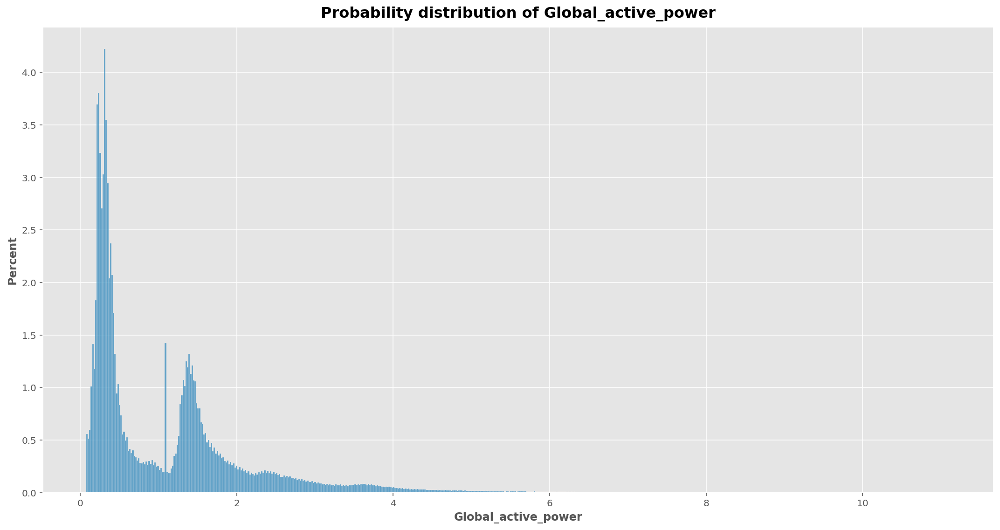

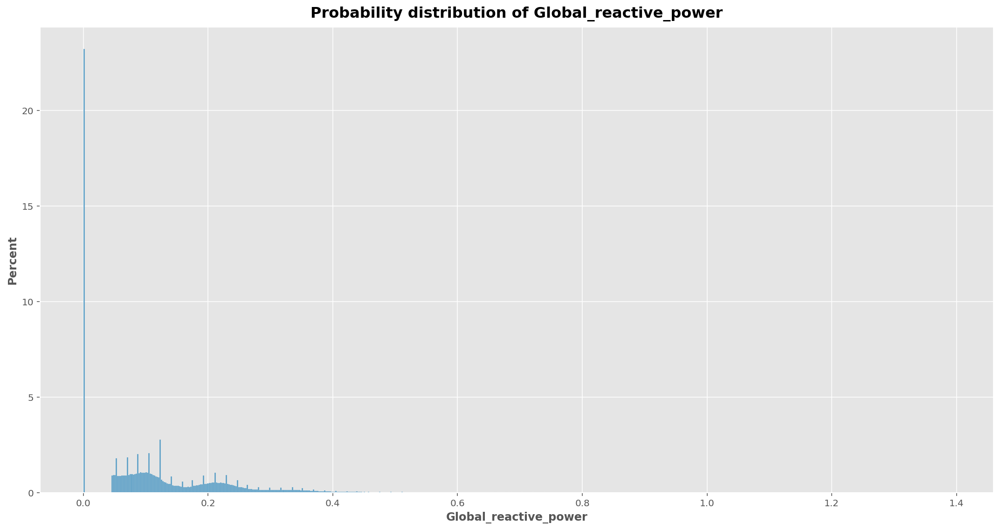

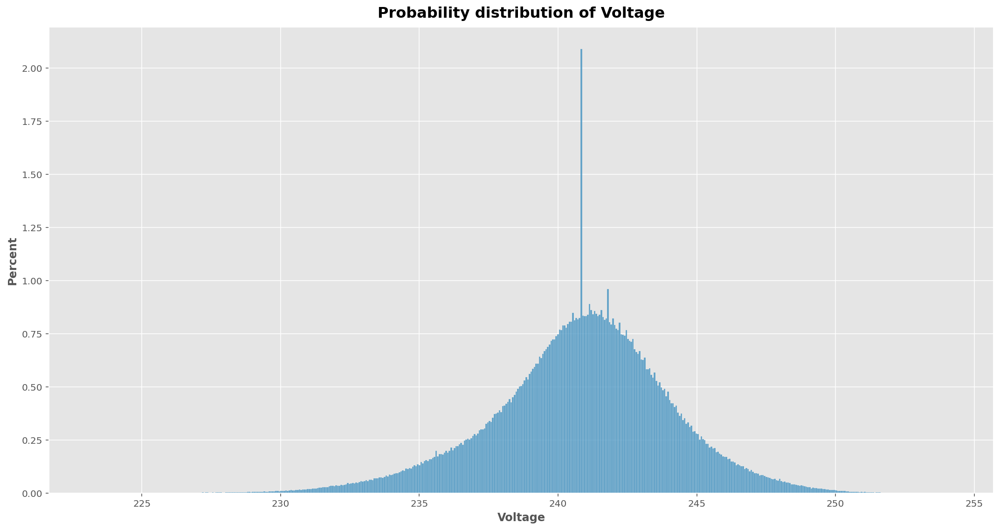

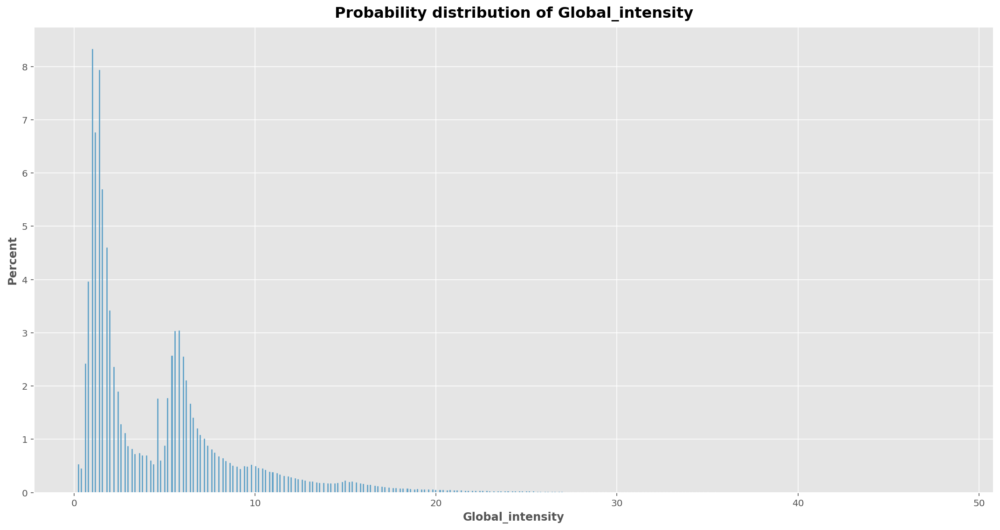

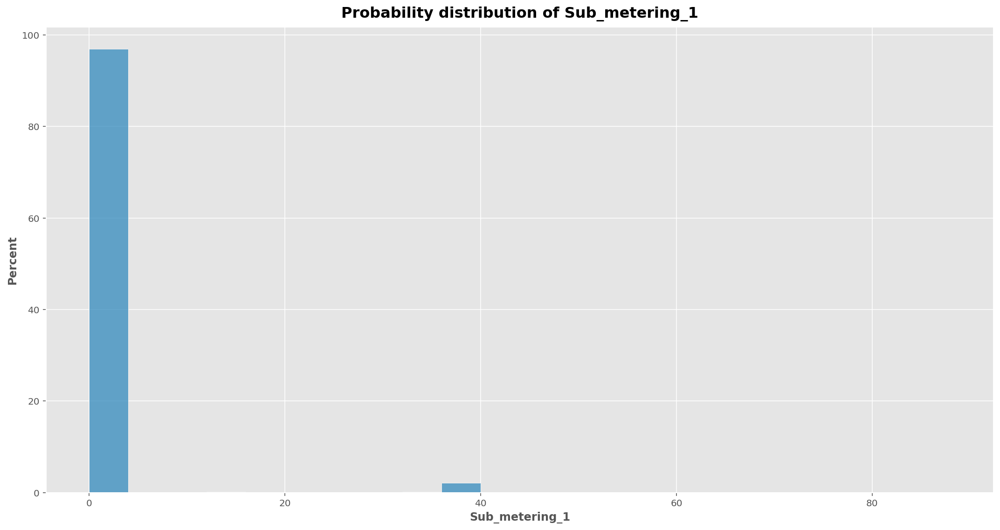

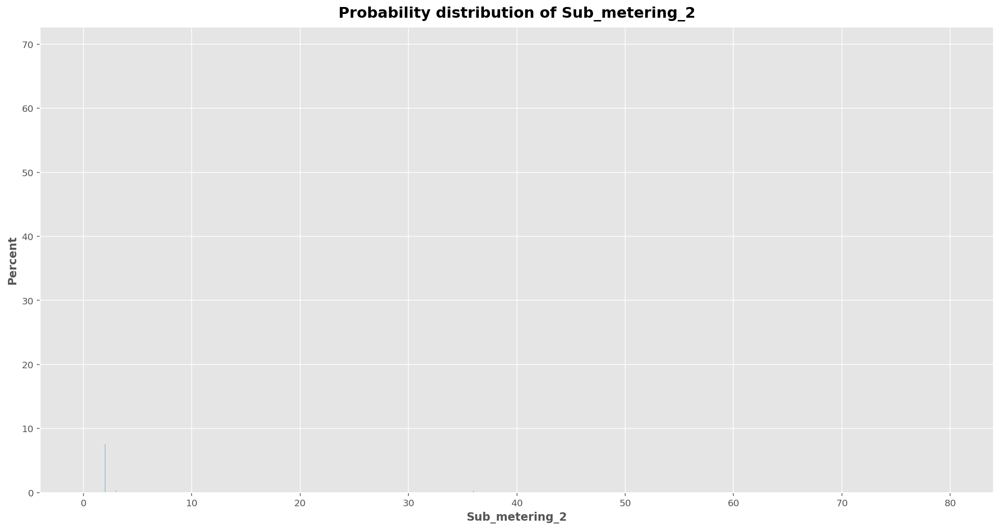

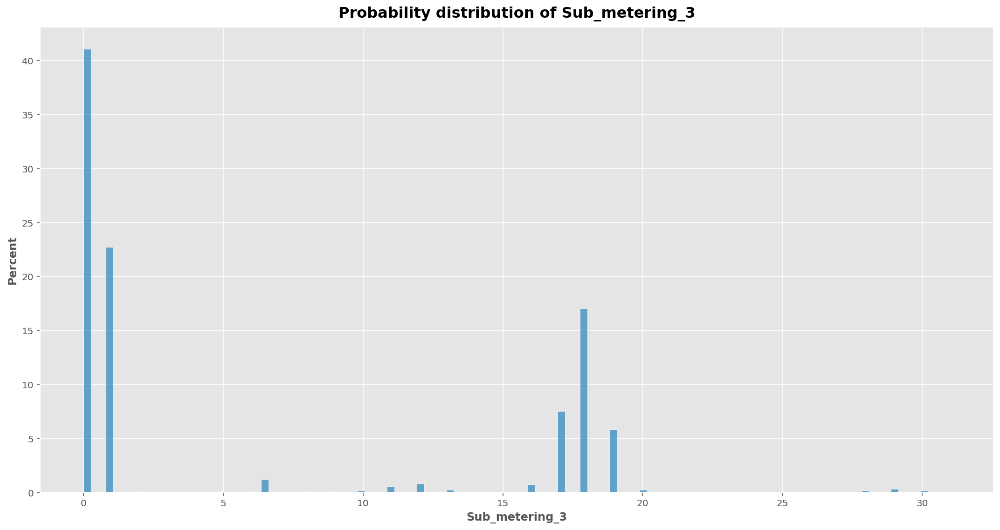

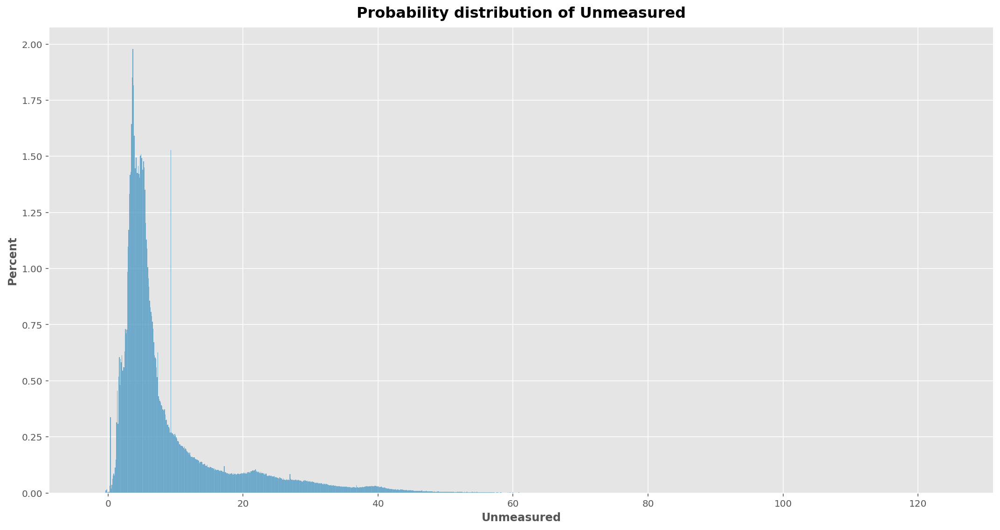

In [17]:
sns.color_palette("husl", 8)
for i in df.columns:
    plt.figure()
    sns.histplot(data=df, x=i, stat="percent")
    plt.title("Probability distribution of " + i)

## What we can tell from distributions:
- Global active power (GAP) is bimodally distributed with two peaks between 0 and 2.
- Global reactive power (GRP) is mostly 0 or near 0, as such we can say it's in line with expectations. 
- Voltage is normally distributed around 242 (France has an average voltage of 230V, so this is slightly higher than usual).
- Global Intensity (GI) is very similar to GAP.
- Sub metering (SM) has negligible influence on household consumption except for SM3 , which has higher peaks between 15 and 20.
- Unmeasured is very centered around 5, somewhat boltzman-like distributed (left-leaning).

<br><br>
***
<br><br>

# Exploratory Data Analysis cont.
### Exploring each column to understand the data


# _Resampling the data so that we can actually graph it_

In [18]:
# function to regroup the data for our purposes
def setup_data(df):
    df_hourly = df.resample("h").mean()
    df_daily = df.resample("d").mean()
    df_weekly = df.resample("W-MON").mean()
    df_monthly = df.resample("m").mean()
    df_yearly = df.resample("h").mean()
    return df_hourly, df_daily, df_weekly, df_monthly, df_yearly

In [19]:
df_hourly, df_daily, df_weekly, df_monthly, df_yearly = setup_data(df)

## Correlation matrix
_First I'll plot the correlation matrix to see if we have any relationships in the Data_

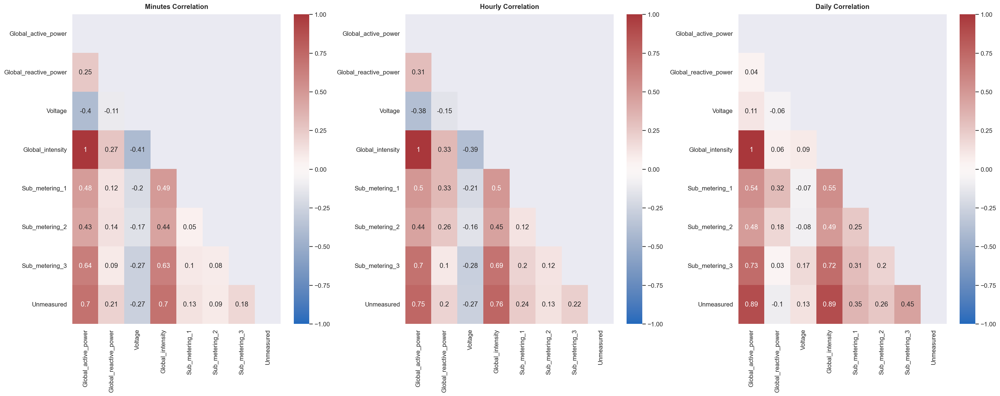

In [442]:
sns.set(font_scale=1)
plt.rc("figure", autolayout=True, figsize=(25, 10))
fig, ax = plt.subplots(1, 3)

matrix = df.corr().round(2)
mask = np.triu(np.ones_like(matrix, dtype=bool))
sns.heatmap(
    matrix, annot=True, vmax=1, vmin=-1, center=0, cmap="vlag", mask=mask, ax=ax[0]
)
ax[0].set_title("Minutes Correlation", size=12)

matrix = df_hourly.corr().round(2)
mask = np.triu(np.ones_like(matrix, dtype=bool))
sns.heatmap(
    matrix, annot=True, vmax=1, vmin=-1, center=0, cmap="vlag", mask=mask, ax=ax[1]
)
ax[1].set_title("Hourly Correlation", size=12)

matrix = df_daily.corr().round(2)
mask = np.triu(np.ones_like(matrix, dtype=bool))
sns.heatmap(
    matrix, annot=True, vmax=1, vmin=-1, center=0, cmap="vlag", mask=mask, ax=ax[2]
)
ax[2].set_title("Daily Correlation", size=12)
plt.show()

## _So what we can infer from this correlation matrix is that:_
- Different time scales have different correlation, but positive/negative relation remain the same
- GAP and GI are perfectly correlated. Which does not line up with expectations that Voltage is not also  perfectly correlated since $Power = Voltage * Current$ (Current is intensity in this case)
- GAP is correlated with SM1 ,SM2 ,SM3 and unmeasured as expected, since  those 4 features stem from GAP
- It is unexpected that GAP and GRP are only slightly positively correlated, since reactive power is the remaining unused power, it should be oppositely correlated. Lets explore this!

<br><br>
***
<br><br>
## Global Active Power & Reactive Power (averaged per day)

<AxesSubplot:xlabel='dt'>

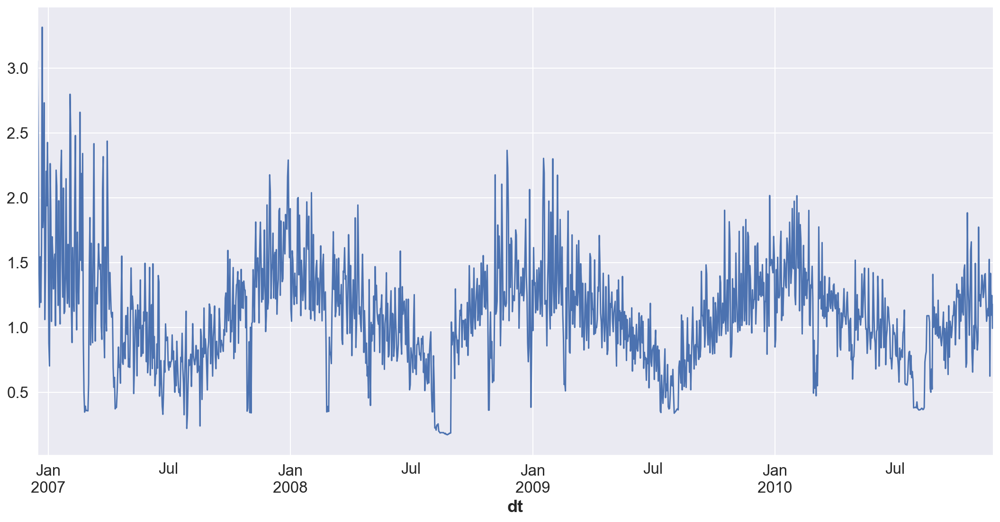

In [14]:
df_daily.Global_active_power.plot()

<AxesSubplot:ylabel='Frequency'>

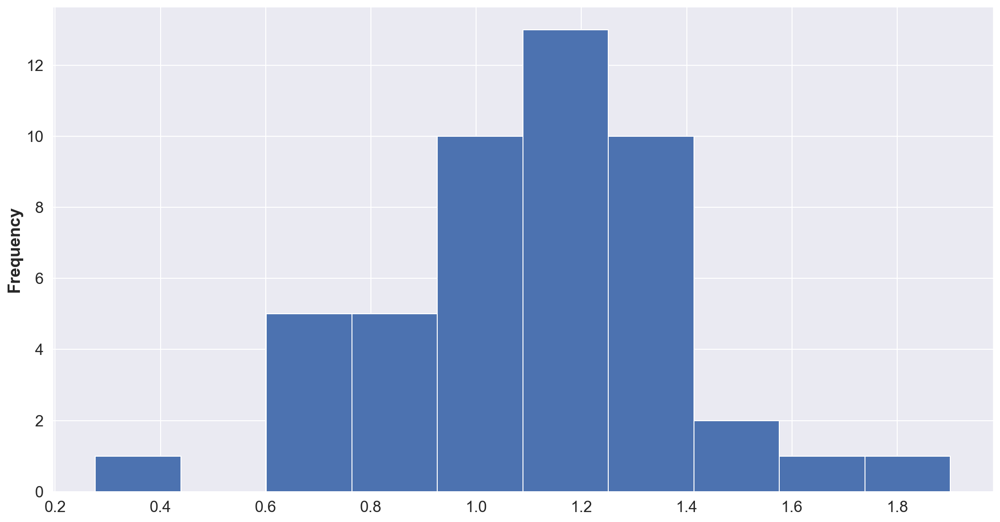

In [15]:
df_monthly.Global_active_power.plot(kind="hist")

_The monthly graph looks clean, but it's a little too clean and gets rid of most of the detail that the daily graph gives._
- The monthly graph averages every day of every hour of every minute, the step size is too wide and misses the trends we might want

Let's explore reactive vs active power with a correlation plot

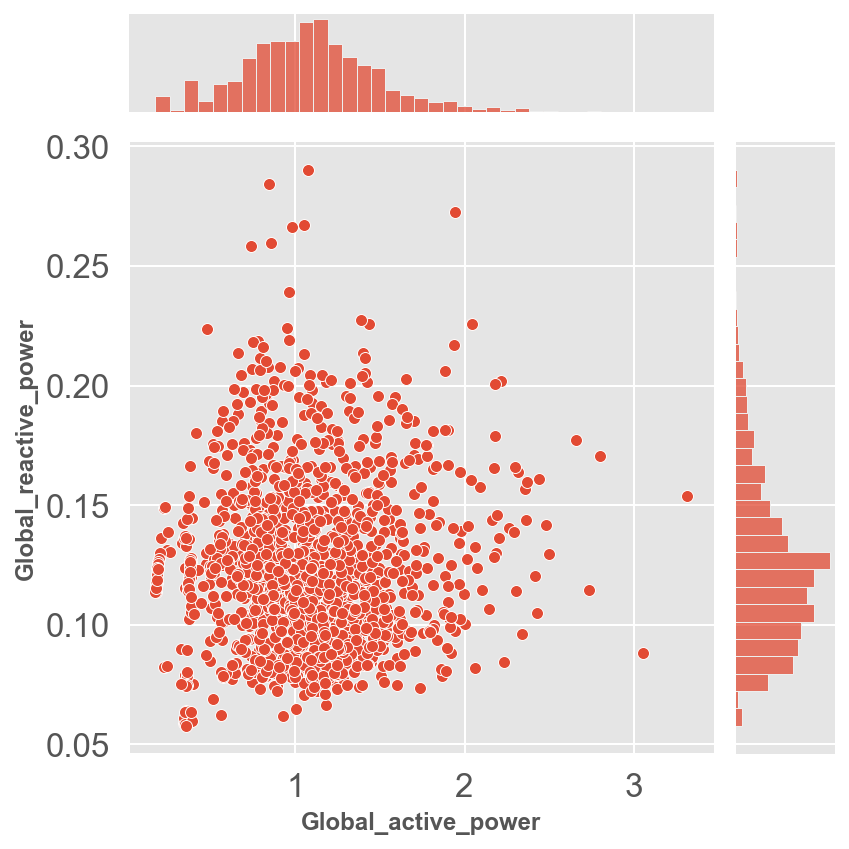

In [62]:
sns.jointplot(x="Global_active_power", y="Global_reactive_power", data=df_daily)

The data is grouped bottom left but there is no clear trend, let's try putting them on the same graph

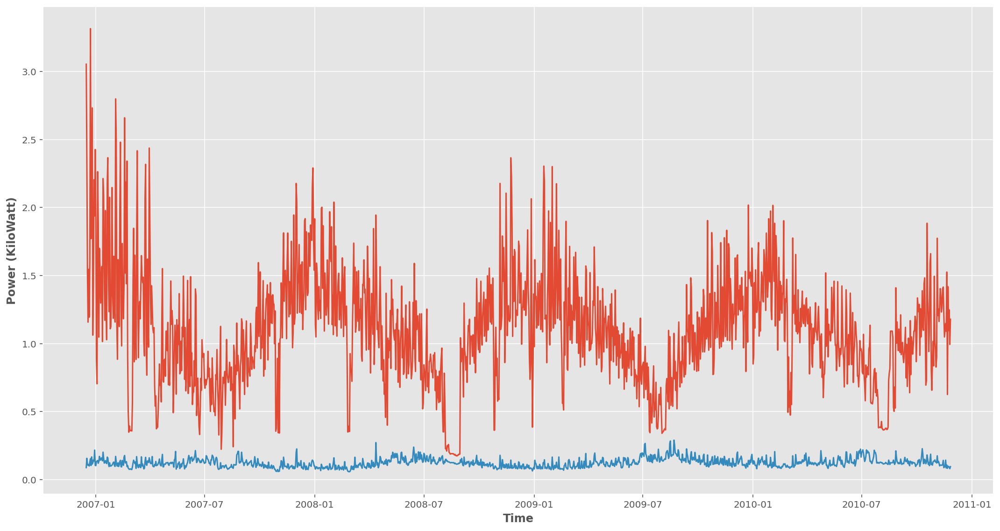

In [22]:
fig, ax = plt.subplots()
for power in ["Global_active_power", "Global_reactive_power"]:
    ax.plot(df_daily[power])
    plt.ylabel("Power (KiloWatt)")
    plt.xlabel("Time")

### Looks like reactive power is much smaller, so we can't see the trend, lets scale it up!

C:\Users\Adrian_Lam\anaconda3\envs\juplab\lib\site-packages\ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Calling add_axes() without argument is deprecated since 3.3 and will be removed two minor releases later. You may want to use add_subplot() instead.
  """
C:\Users\Adrian_Lam\anaconda3\envs\juplab\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


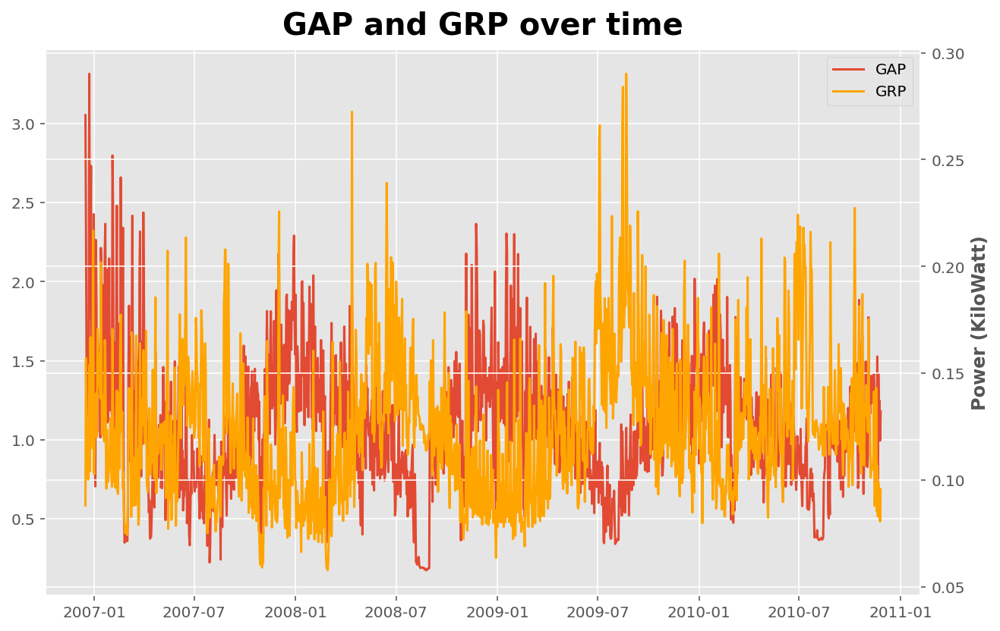

In [23]:
fig = plt.figure(figsize=(8, 5))
line_weight = 3
alpha = 0.5
ax1 = fig.add_axes([0, 0, 1, 1])
ax2 = fig.add_axes()
# This is the magic that joins the x-axis
ax2 = ax1.twinx()
lns1 = ax1.plot(df_daily.Global_active_power, label="GAP")
lns2 = ax2.plot(df_daily.Global_reactive_power, color="orange", label="GRP")
# Solution for having two legends
leg = lns1 + lns2
labs = [l.get_label() for l in leg]
ax1.legend(leg, labs, loc=0)
plt.title("GAP and GRP over time", fontsize=20)
plt.ylabel("Power (KiloWatt)")
plt.xlabel("Time")
plt.show()

_Even though the correlation calculations don't support it, visually they are inversely correlated. The change in GAP and GRP over time are inversely related. (To prove at a later date)_

Let's look at the plots of other features and see if we can infer anything else

<br><br>
***
<br><br>
## Voltage and GAP

Text(0.5, 0, 'Time')

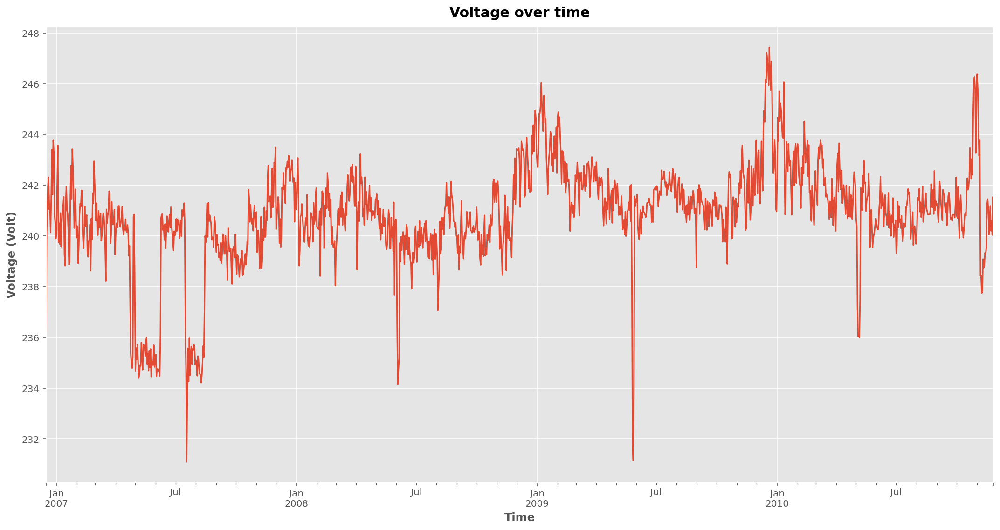

In [46]:
df_daily.Voltage.plot()
plt.title("Voltage over time", fontsize=15)
plt.ylabel("Voltage (Volt)")
plt.xlabel("Time")  

### Those are some very odd dips at May and August 2007, we will keep an eye out for other dips like this
#### Let's plot voltage and GAP together to see if there is a higher correlation that we thought

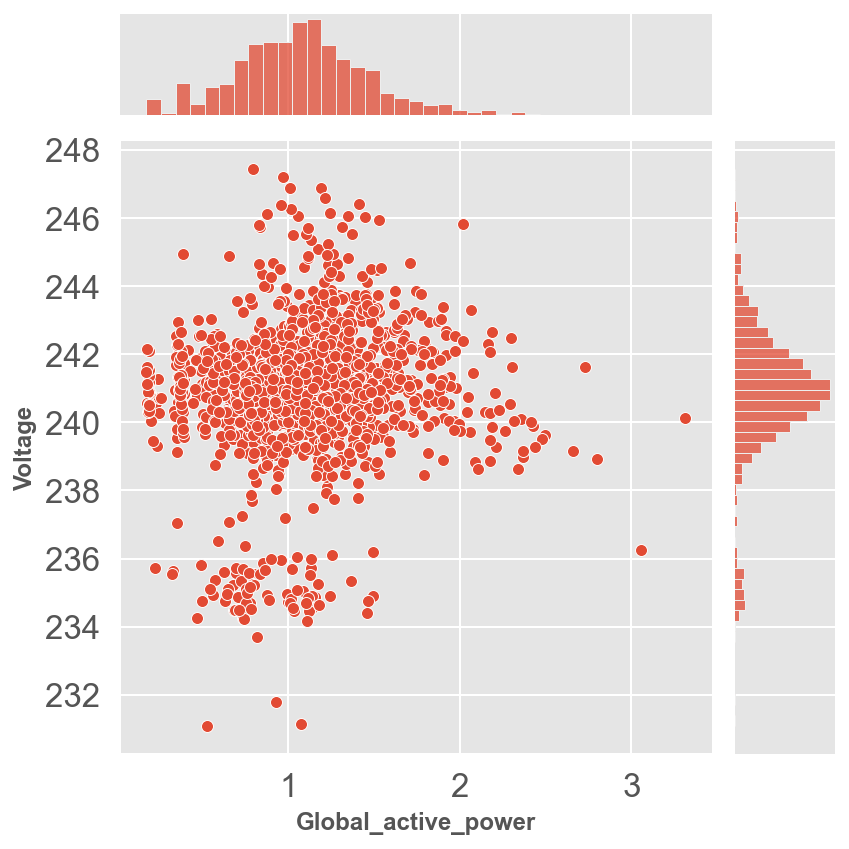

In [63]:
sns.jointplot(x="Global_active_power", y="Voltage", data=df_daily)

_This correlation plot groups a lot of points together but isn't useful for us to see any trends._ \
_Let's try to put it together with GAP like we did with GRP_

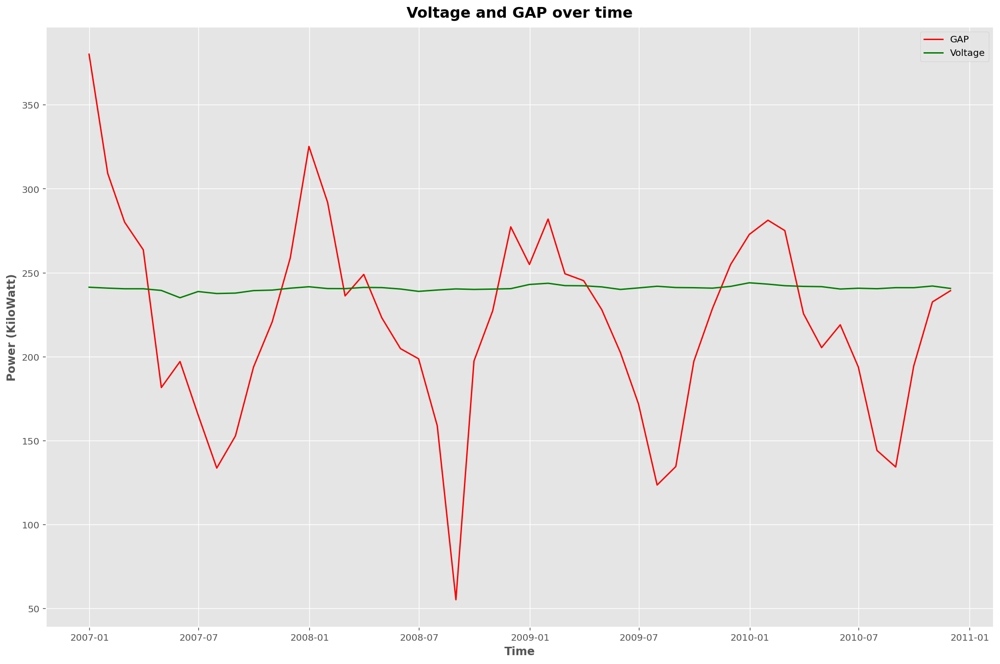

In [47]:
plt.rcParams["figure.figsize"] = [15, 10]
plt.rcParams["figure.autolayout"] = True

# multiply by 200 to scale
plt.plot(df_monthly.Global_active_power * 200, c="red", label="GAP")
plt.plot(df_monthly.Voltage, c="green", label="Voltage")
plt.title("Voltage and GAP over time")
plt.ylabel("Power (KiloWatt)")
plt.xlabel("Time")  
plt.legend()

### The voltage doesn't really change with GAP, but it makes sense now. Since if voltage stays constant, e.g. 1 then the current becomes pretty much equal to power, which makes it have a correlation of 1! 
$P = 1 * Intensity$

Text(0.5, 0, 'Time')

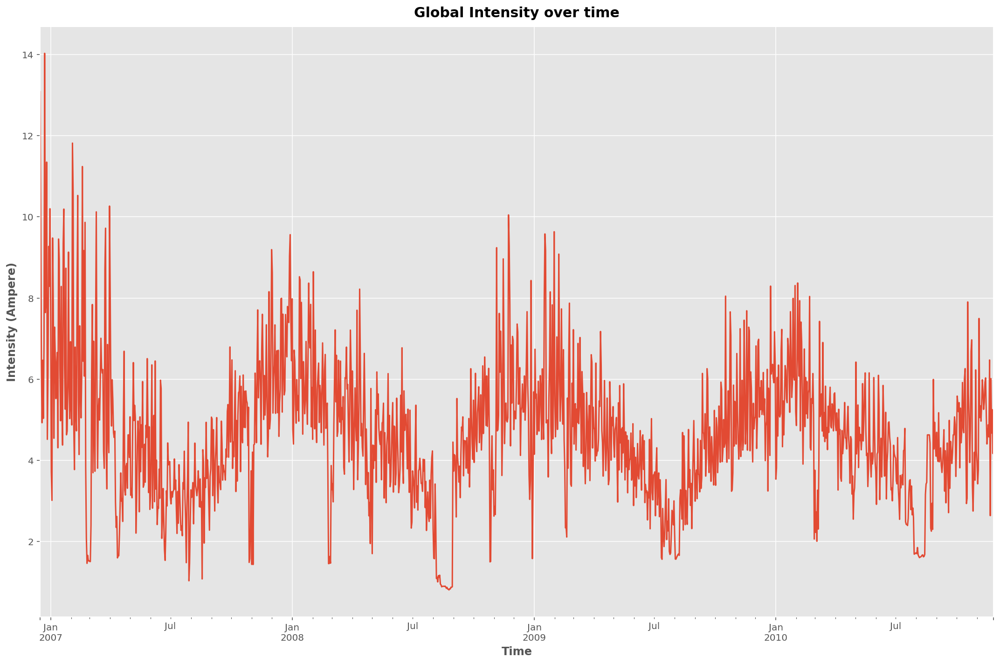

In [48]:
df_daily.Global_intensity.plot()
plt.title("Global Intensity over time", fontsize=15)
plt.ylabel("Intensity (Ampere)")
plt.xlabel("Time")  

Lets overlap GI and GAP to see if the correlation is as perfect as the matrix says

C:\Users\Adrian_Lam\anaconda3\envs\juplab\lib\site-packages\ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Calling add_axes() without argument is deprecated since 3.3 and will be removed two minor releases later. You may want to use add_subplot() instead.
  """
C:\Users\Adrian_Lam\anaconda3\envs\juplab\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


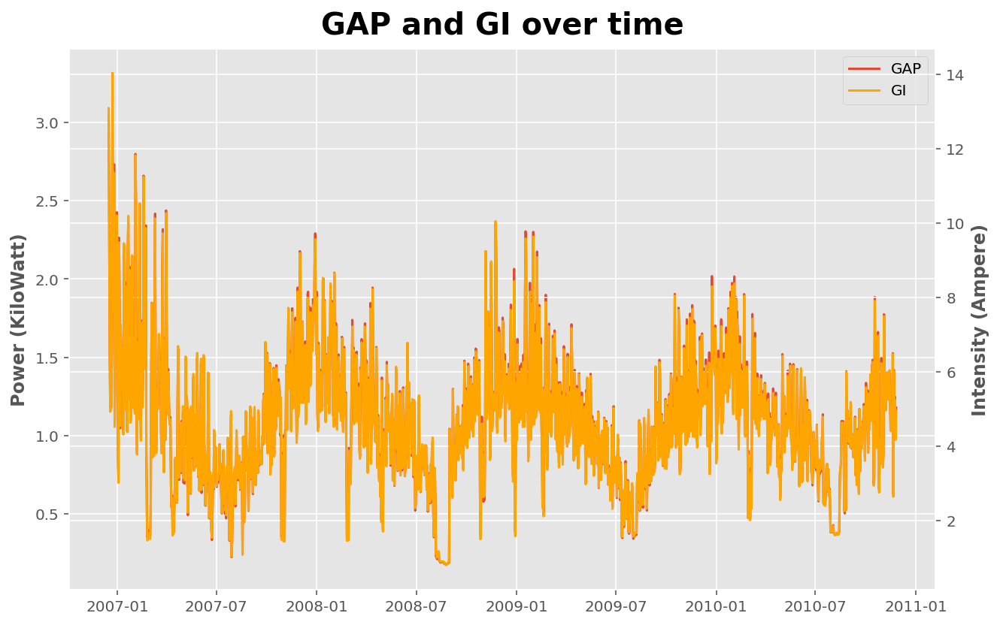

In [49]:
fig = plt.figure(figsize=(8, 5))
line_weight = 3
alpha = 0.5
ax1 = fig.add_axes([0, 0, 1, 1])
ax2 = fig.add_axes()
# This is the magic that joins the x-axis
ax2 = ax1.twinx()
lns1 = ax1.plot(df_daily.Global_active_power, label="GAP")
lns2 = ax2.plot(df_daily.Global_intensity, color="orange", label="GI")
# Solution for having two legends
leg = lns1 + lns2
labs = [l.get_label() for l in leg]
ax1.legend(leg, labs, loc=0)
plt.title("GAP and GI over time", fontsize=20)
ax1.set_ylabel('Power (KiloWatt)')
ax2.set_ylabel('Intensity (Ampere)')
plt.show()

As expected (from correlation graph), we can see that they are almost identical when overlapped.

<br><br>
***
<br><br>
## Sub metering

Text(0.5, 0, 'Time')

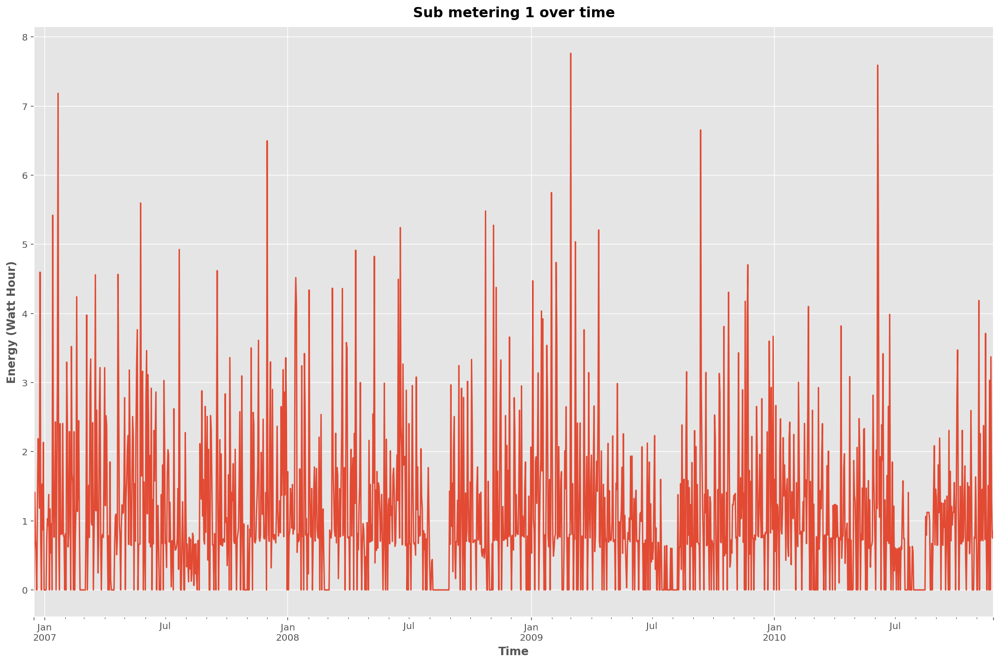

In [50]:
df_daily.Sub_metering_1.plot()
plt.title("Sub metering 1 over time", fontsize=15)
plt.ylabel("Energy (Watt Hour)")
plt.xlabel("Time")  

Very unhelpful messy data, lets try monthly instead.

Text(0.5, 0, 'Time')

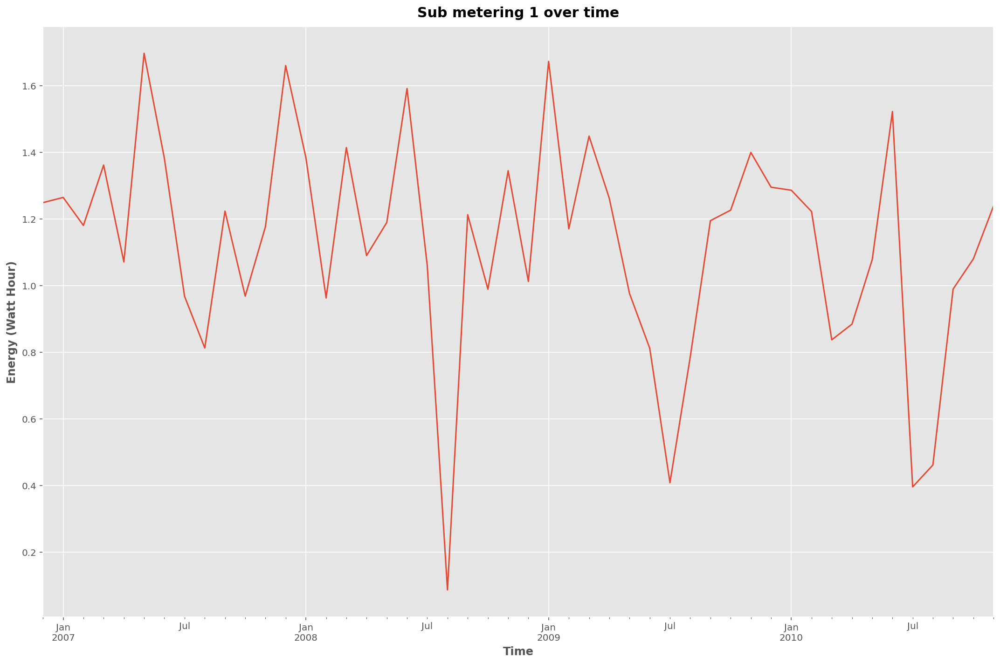

In [51]:
df_monthly.Sub_metering_1.plot()
plt.title("Sub metering 1 over time", fontsize=15)
plt.ylabel("Energy (Watt Hour)")
plt.xlabel("Time")  

Text(0.5, 0, 'Time')

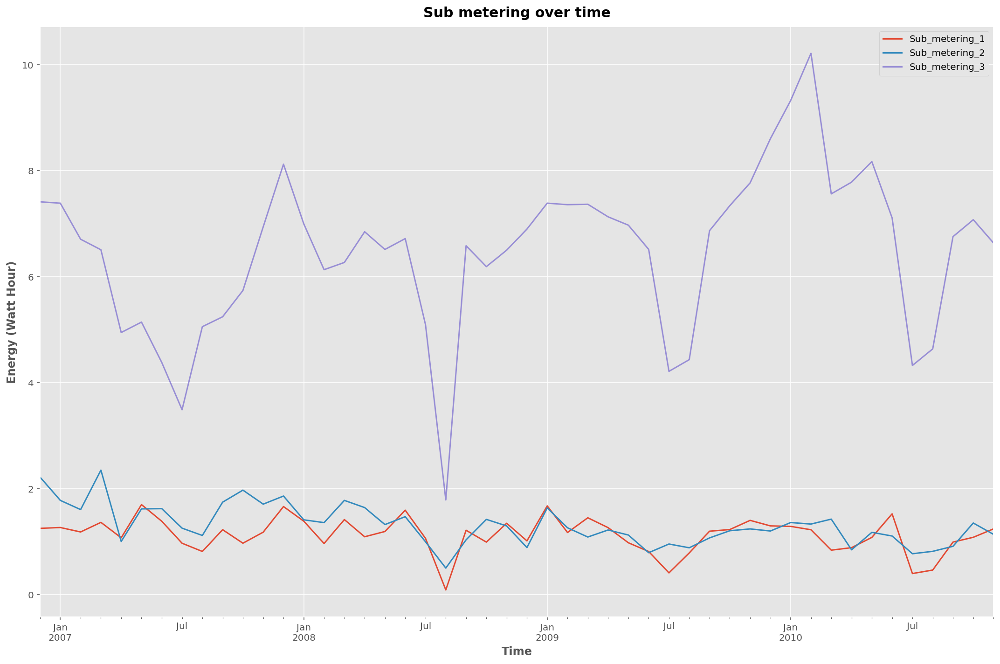

In [52]:
df_monthly.Sub_metering_1.plot(legend=True)
df_monthly.Sub_metering_2.plot(legend=True)
df_monthly.Sub_metering_3.plot(legend=True)
plt.title("Sub metering over time", fontsize=15)
plt.ylabel("Energy (Watt Hour)")
plt.xlabel("Time")  

Text(0.5, 0, 'Time')

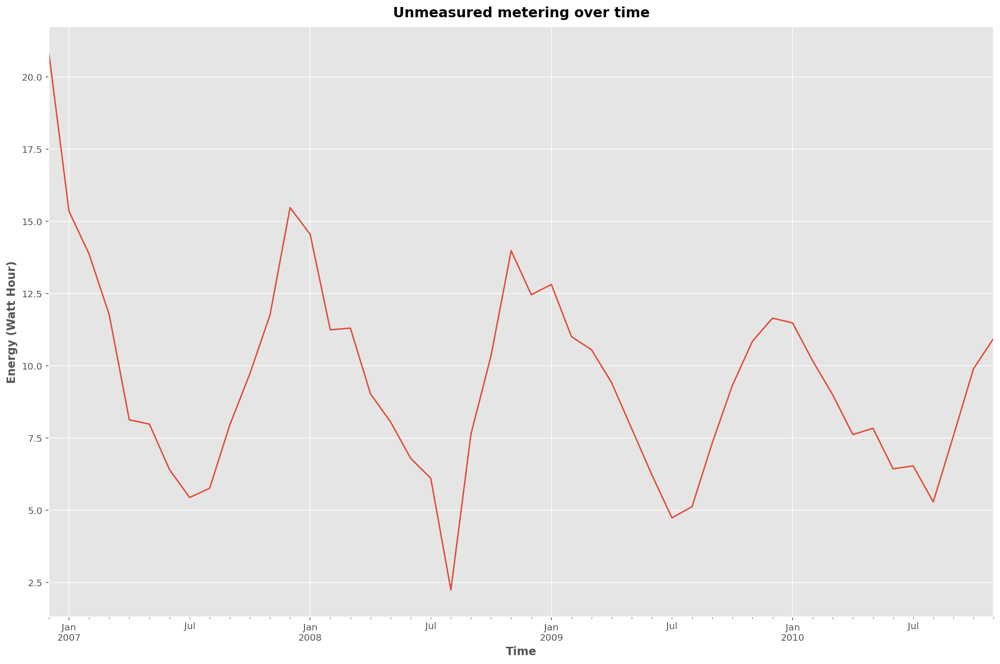

In [53]:
df_monthly.Unmeasured.plot()
plt.title("Unmeasured metering over time", fontsize=15)
plt.ylabel("Energy (Watt Hour)")
plt.xlabel("Time")  

## _Looks like SM2 and 3 are relatively stable/flat over time but SM1 has huge dips in july and huge peaks in January._
### This makes lots of sense because:
SM1 corresponds to the kitchen, containing mainly a dishwasher, an oven and a microwave (hot plates are not electric but gas powered).\
These are utility that people use every day so it should remain roughly the same everyday.

SM2 corresponds to the laundry room, containing a washing-machine, a tumble-drier, a refrigerator and a light. which are also utilities used daily.

SM3 corresponds to an electric water-heater and an air-conditioner which are seasonally used utility, which makes sense for them to have some seasonality. 

#### The dips in July/August could be due to vacations, since those months are very popular for having vacations, reducing power usage by a lot.


<br><br>
***
<br><br>


# Time Series Plots

### _To get started, I'll plot all the columns with moving averages with an annual rolling window._

### _This will allow us to see the overall trend of every column of our data over time!_

In [55]:
def rolling_window_plot(target, window):
    moving_average = (
        df_daily[target]
        .rolling(
            window=window,  # target
            center=True,  # puts the average at the center of the window
            min_periods=window // 2,  # choose about half the window size
        )
        .mean()
    )
    plt.figure()
    ax = df_daily[target].plot(style=".", color="0.5")
    moving_average.plot(
        ax=ax,
        linewidth=3,
        title=target + " " + str(window) + " Day Moving Average",
        legend=True,
    )
    plt.ylabel(target)
    plt.xlabel("Time")  

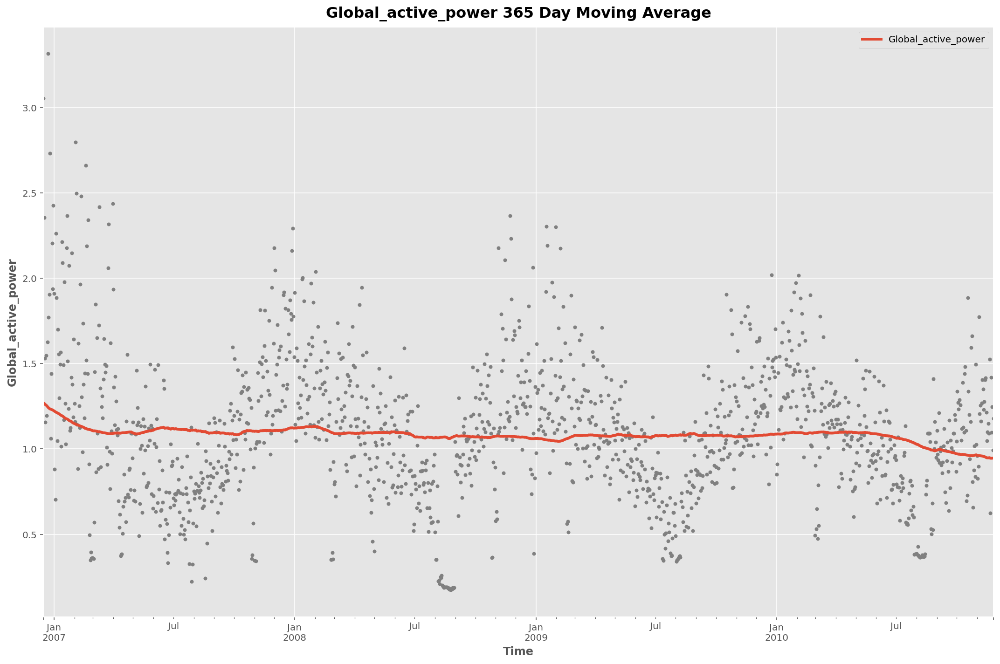

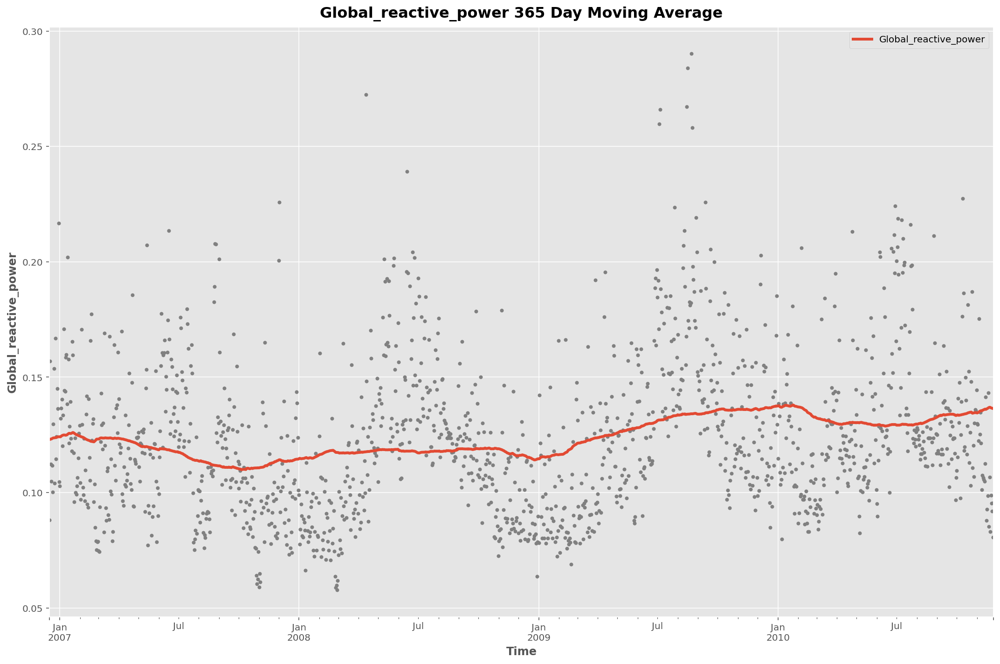

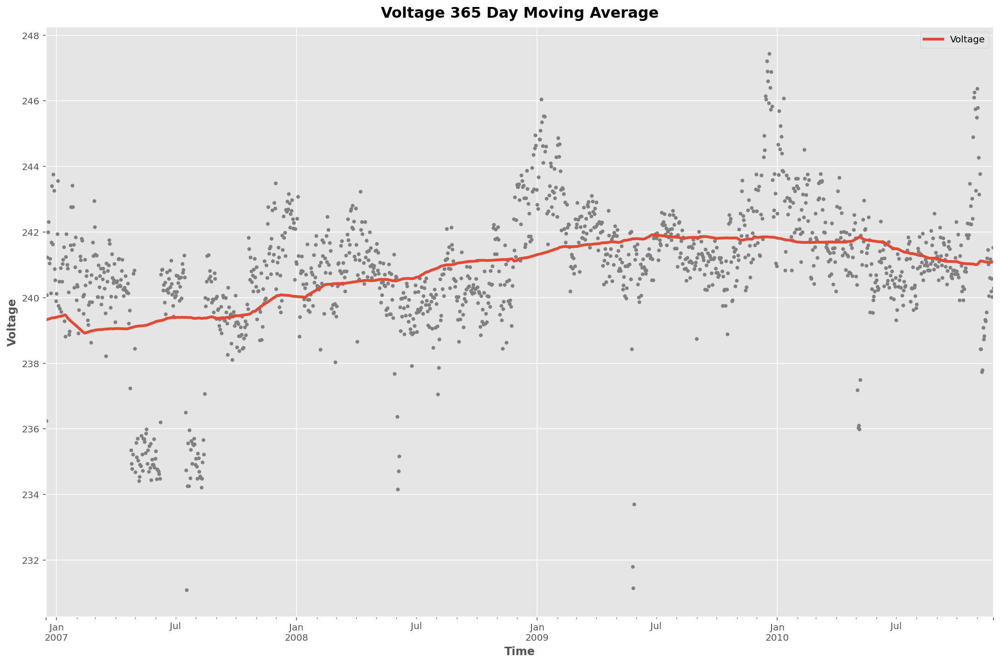

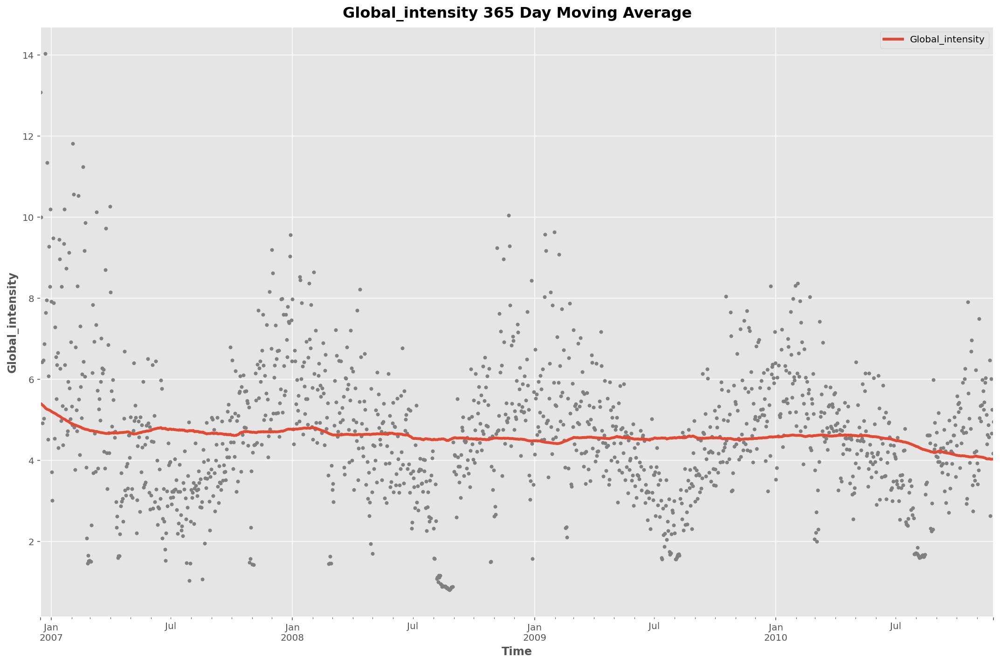

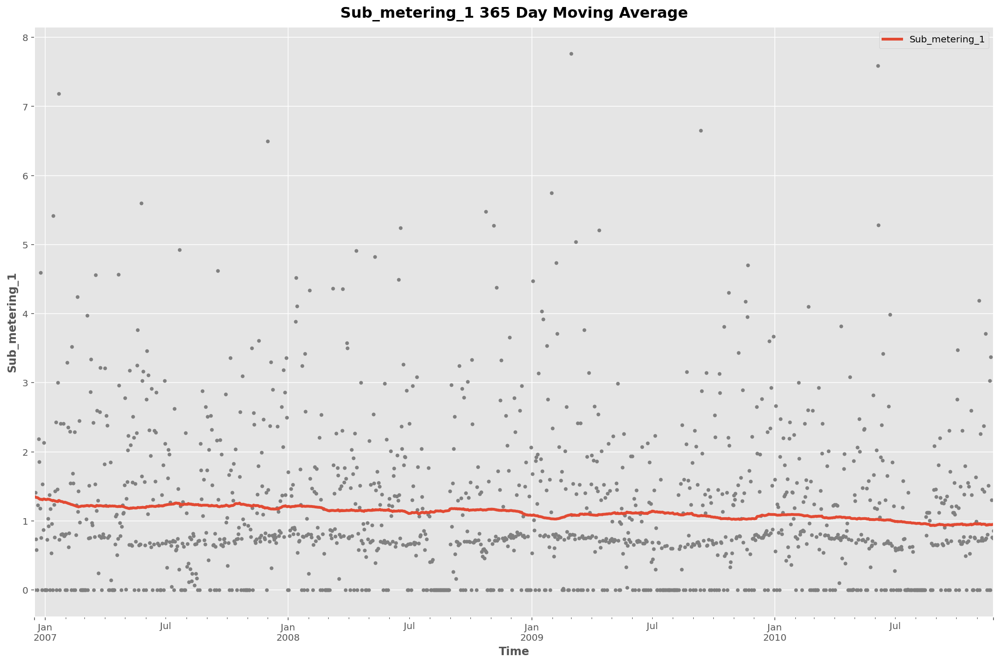

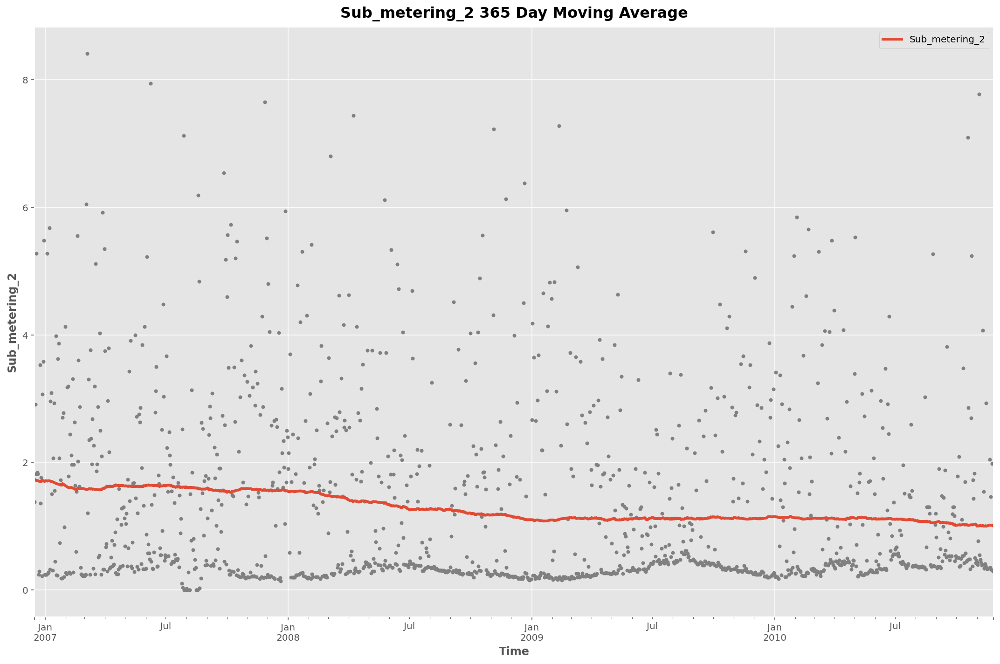

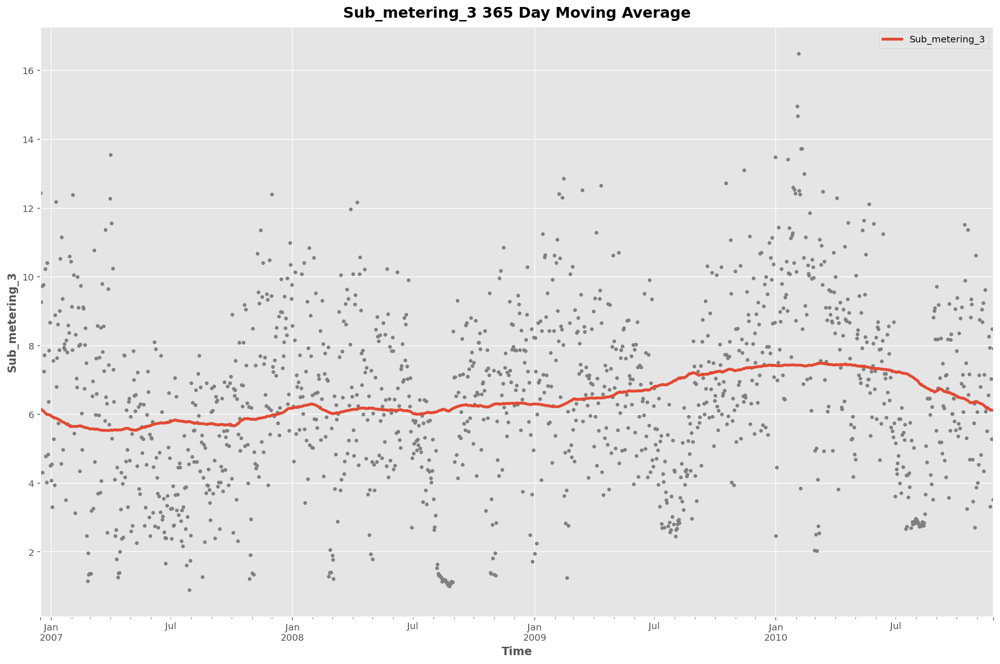

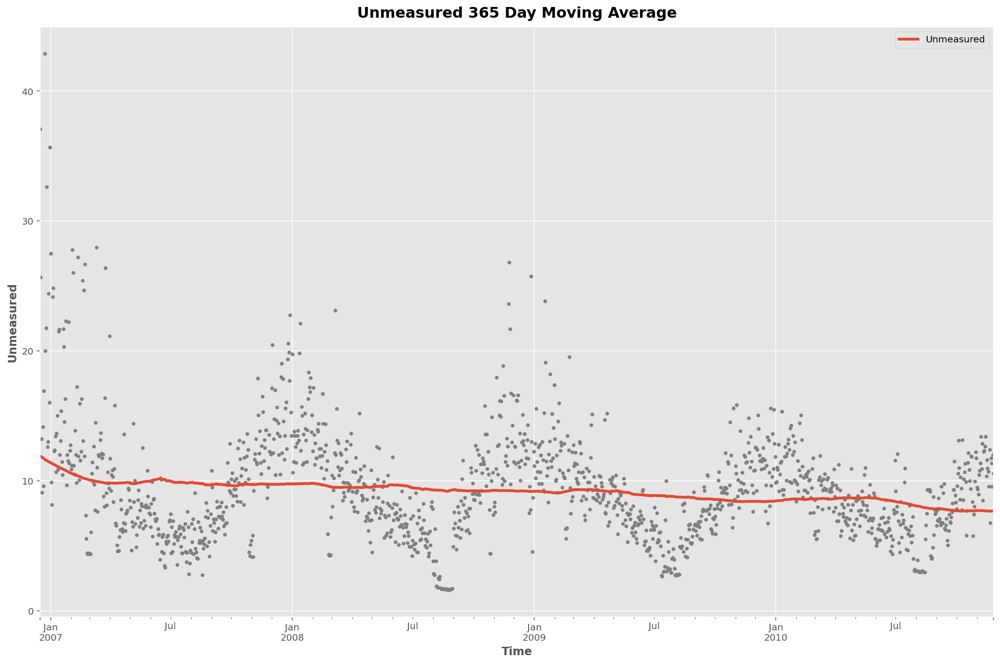

In [56]:
for i in df_daily.columns:
    rolling_window_plot(str(i), 365)

# Overall trends we can see:
Increasing:
- Voltage
- Global reactive power

Stable:
- Global Intensity
- SM1

Decreasing:
- Global active power
- SM2, SM3

### Since a lot of them can be hard to judge, we can apply Linear Regression onto it and see if that gives us a better trend.

<br> <br>
***
<br> <br>

## Trends with Linear Regression

In [57]:
def trend_forecasting(target):

    dp = DeterministicProcess(
        index=df_daily.index,  # dates from the training data
        constant=True,  # dummy feature for the bias (y_intercept)
        order=1,  # the time dummy (trend)
        drop=True,  # drop terms if necessary to avoid collinearity
    )
    # `in_sample` creates features for the dates given in the `index` argument
    X = dp.in_sample()

    y = df_daily[target]  # the target

    # The intercept is the same as the `const` feature from
    # DeterministicProcess. LinearRegression behaves badly with duplicated
    # features, so we need to be sure to exclude it here.
    model = LinearRegression(fit_intercept=False)
    model.fit(X, y)

    y_pred = pd.Series(model.predict(X), index=X.index)

    X = dp.out_of_sample(steps=30)

    y_fore = pd.Series(model.predict(X), index=X.index)
    plt.figure()
    ax = y.plot(title=target + " - Linear Trend Forecast", **plot_params)
    ax = y_pred.plot(ax=ax, linewidth=3, label="Trend")
    ax = y_fore.plot(ax=ax, linewidth=3, label="Trend Forecast", color="C3")
    _ = ax.legend()
    plt.ylabel(target)
    plt.xlabel("Time")  

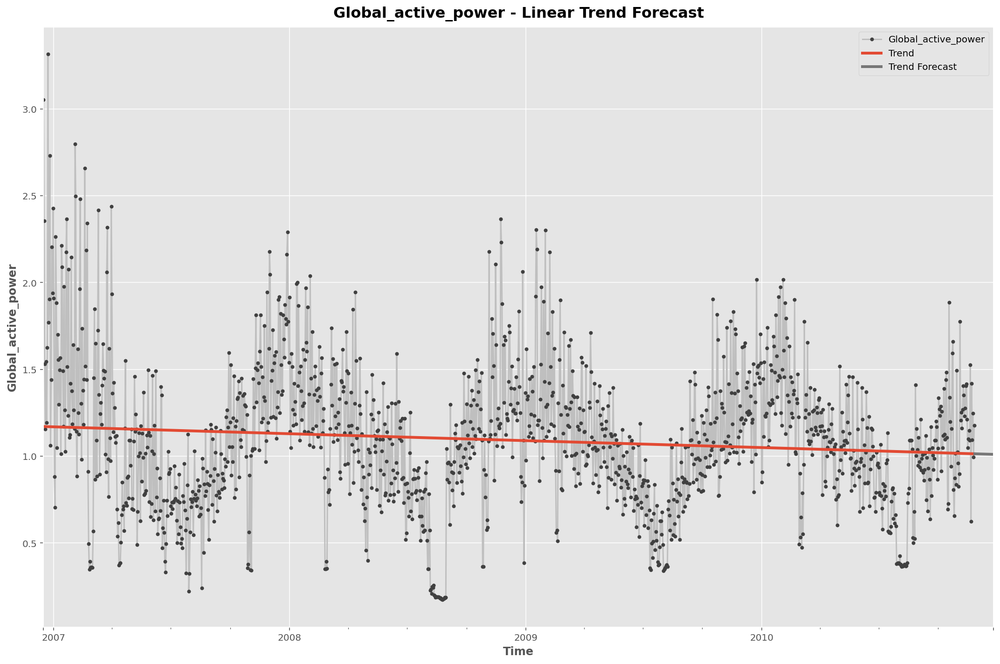

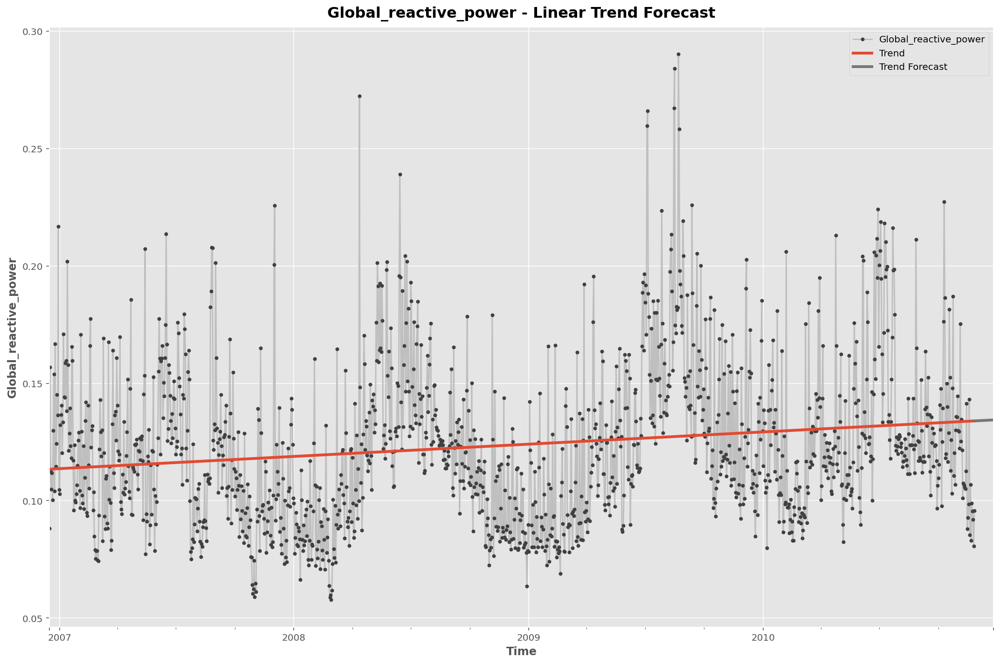

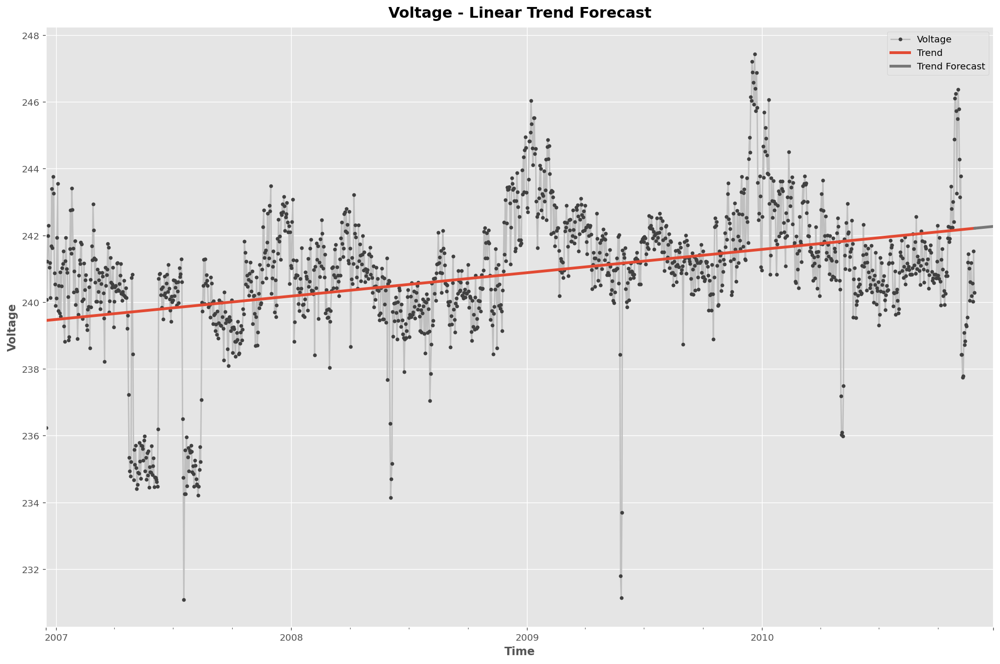

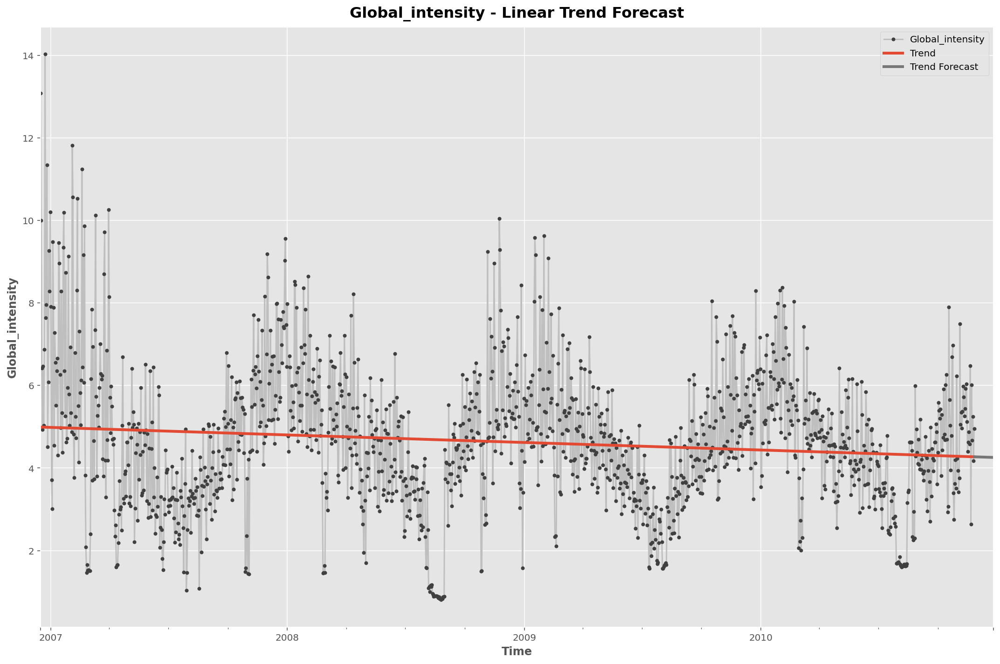

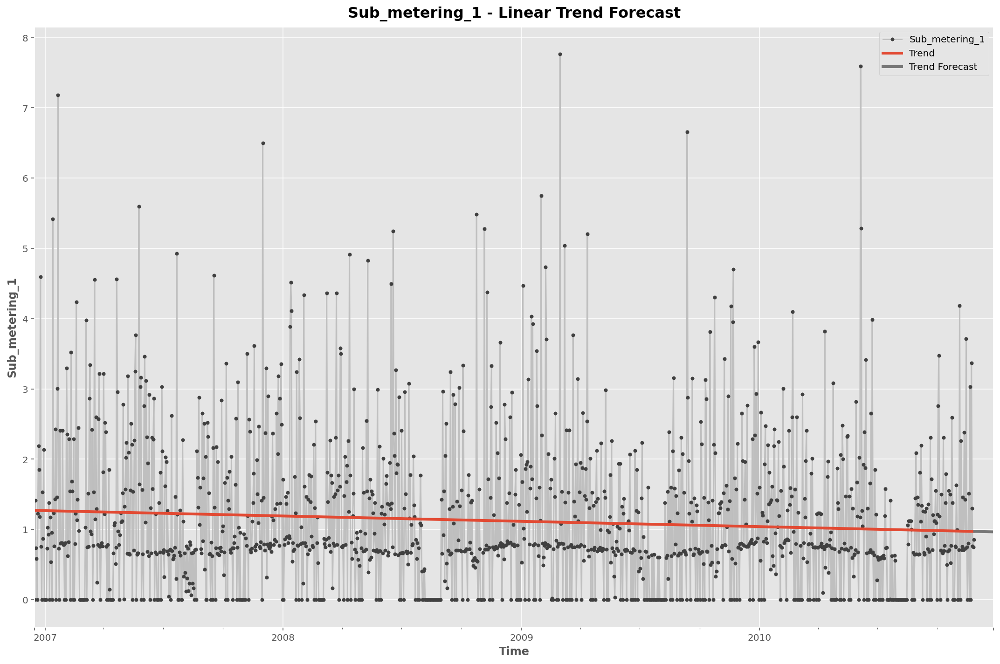

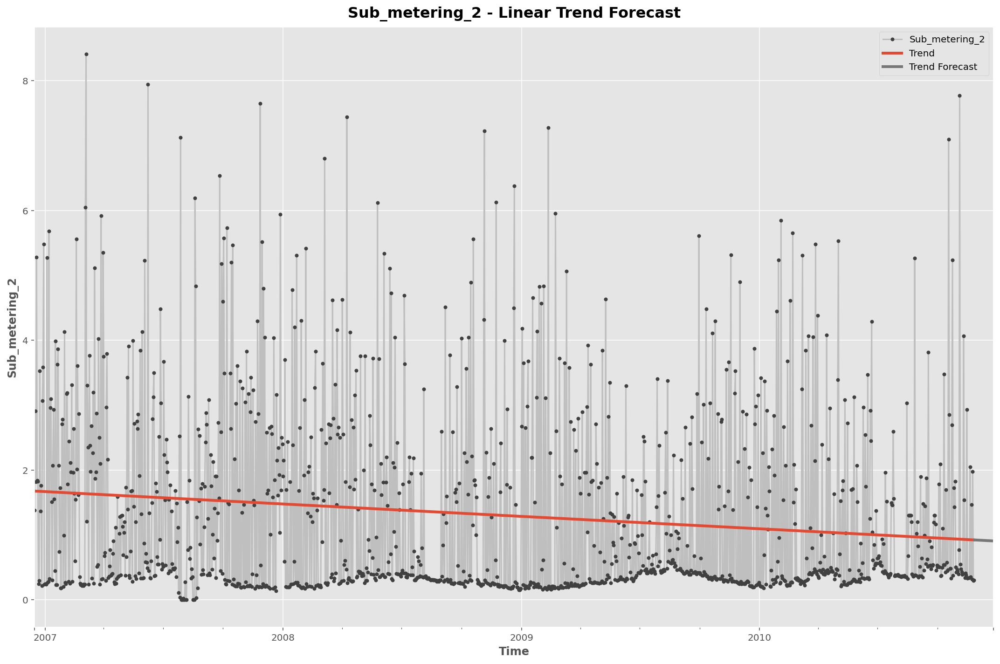

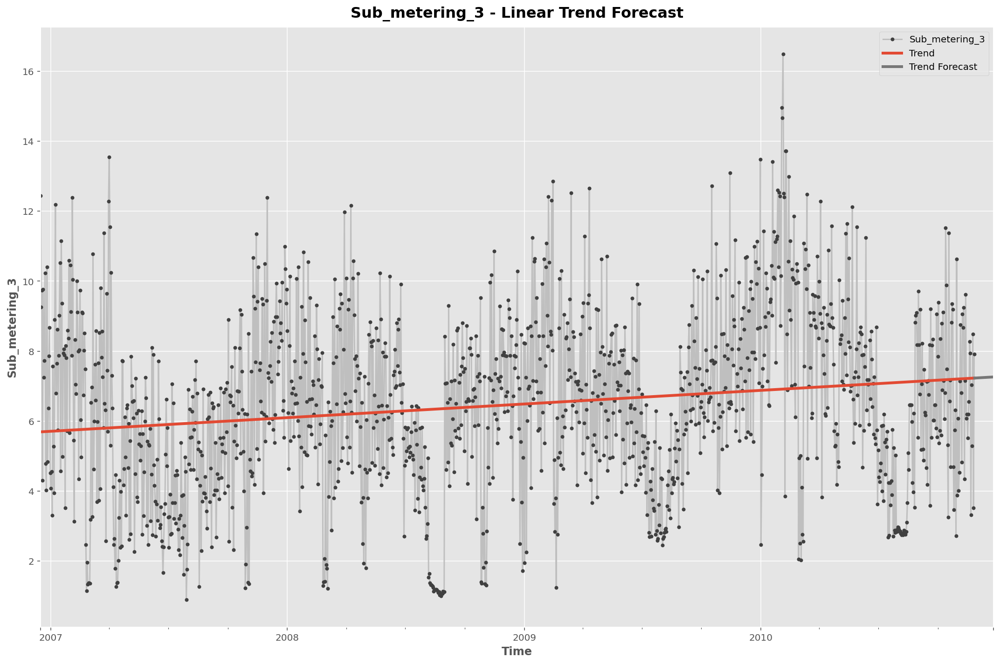

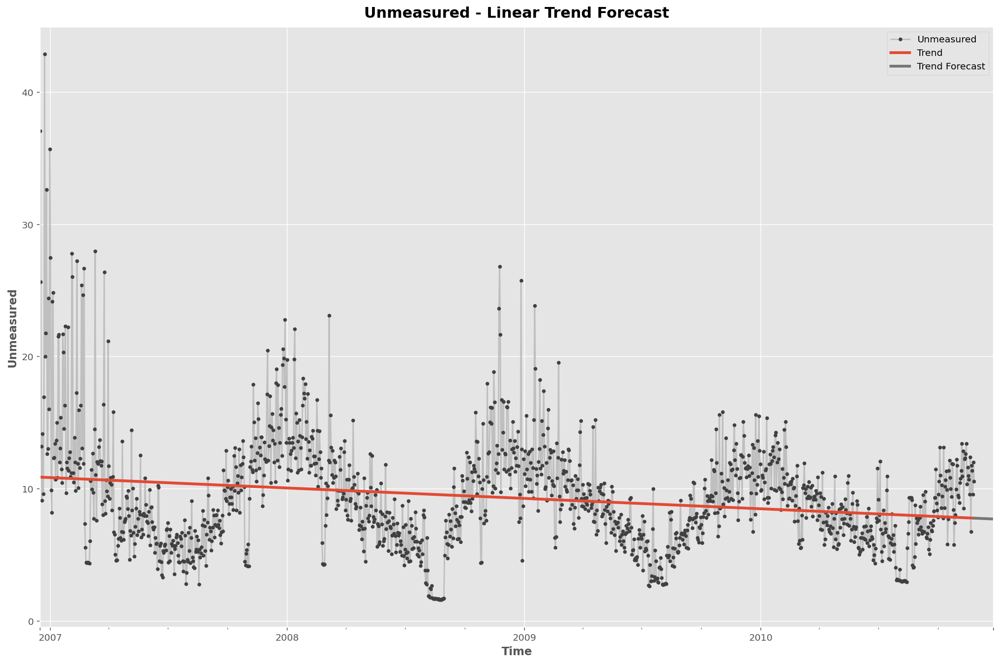

In [58]:
for i in df_daily.columns:
    trend_forecasting(str(i))

# _Much better!_ 
### Now we can see the trend clearly of which ones are increasing over time and which are decreasing:
Increasing:
- GRP
- Voltage
- SM3

Decreasing:
- GAP
- GI
- SM1
- SM2
- Unmeasured

<br> <br>
***
<br> <br>

# Next we can check every column for Serial Dependence : modelling featues past values of the target series. 
### To see if they rely on previous values, or if we can find cycles 
#### _Going to use monthly data so we can get cleaner visualizations_

In [60]:
def lagplot(x, y=None, lag=1, standardize=False, ax=None, **kwargs):

    # redefine Matplotlib defaults so the graphs fit in this
    plt.style.use("ggplot")
    plt.rc("figure", autolayout=True, figsize=(11, 4))
    plt.rc(
        "axes",
        labelweight="bold",
        labelsize="large",
        titleweight="bold",
        titlesize=16,
        titlepad=10,
    )
    # apply shift
    x_ = x.shift(lag)
    if standardize:
        x_ = (x_ - x_.mean()) / x_.std()
    if y is not None:
        y_ = (y - y.mean()) / y.std() if standardize else y
    else:
        y_ = x
    corr = y_.corr(x_)
    # create a new subplot if one doesn't exist
    if ax is None:
        fig, ax = plt.subplots()
    scatter_kws = dict(
        alpha=0.75,
        s=3,
    )
    line_kws = dict(
        color="C3",
    )
    ax = sns.regplot(
        x=x_,
        y=y_,
        scatter_kws=scatter_kws,
        line_kws=line_kws,
        lowess=True,
        ax=ax,
        **kwargs,
    )
    at = AnchoredText(
        f"{corr:.2f}",
        prop=dict(size="large"),
        frameon=True,
        loc="upper left",
    )
    at.patch.set_boxstyle("square, pad=0.0")
    ax.add_artist(at)
    ax.set(title=f"Lag {lag}", xlabel=x_.name, ylabel=y_.name)
    return ax


def plot_lags(x, y=None, lags=6, nrows=1, lagplot_kwargs={}, **kwargs):
    import math

    kwargs.setdefault("nrows", nrows)
    kwargs.setdefault("ncols", math.ceil(lags / nrows))
    kwargs.setdefault("figsize", (kwargs["ncols"] * 2, nrows * 2 + 0.5))
    fig, axs = plt.subplots(sharex=True, sharey=True, squeeze=False, **kwargs)
    for ax, k in zip(fig.get_axes(), range(kwargs["nrows"] * kwargs["ncols"])):
        if k + 1 <= lags:
            ax = lagplot(x, y, lag=k + 1, ax=ax, **lagplot_kwargs)
            ax.set_title(f"Lag {k + 1}", fontdict=dict(fontsize=14))
            ax.set(xlabel="", ylabel="")
        else:
            ax.axis("off")
    plt.setp(axs[-1, :], xlabel=x.name)
    plt.setp(axs[:, 0], ylabel=y.name if y is not None else x.name)
    fig.tight_layout(w_pad=0.1, h_pad=0.1)
    return fig

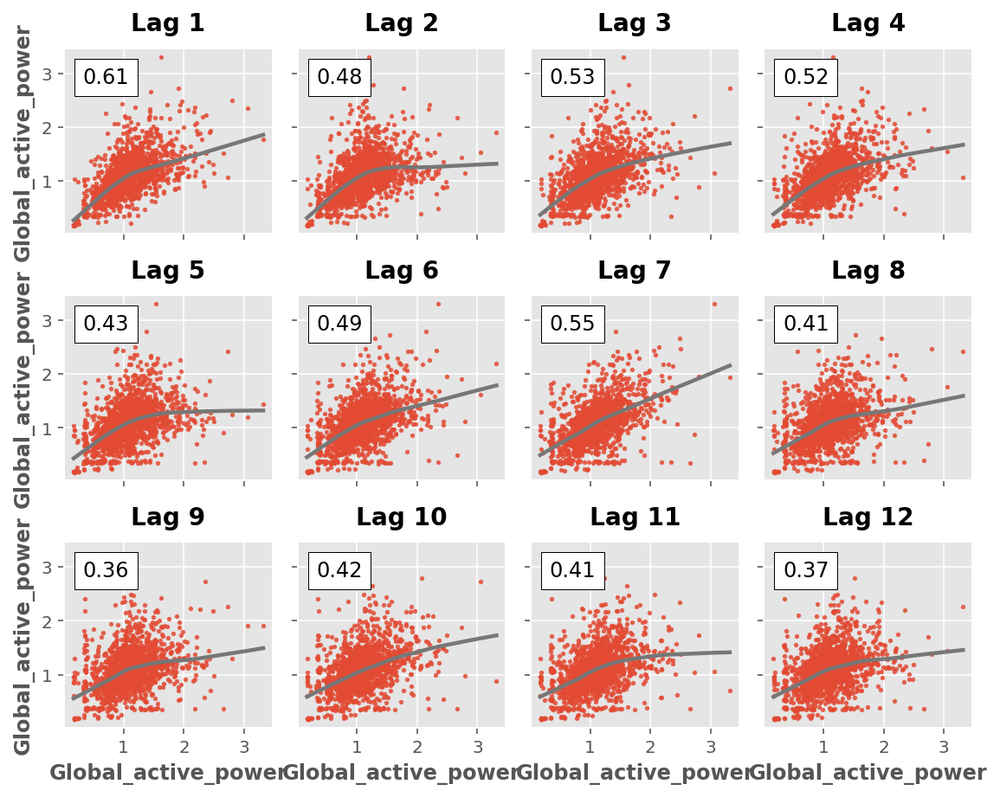

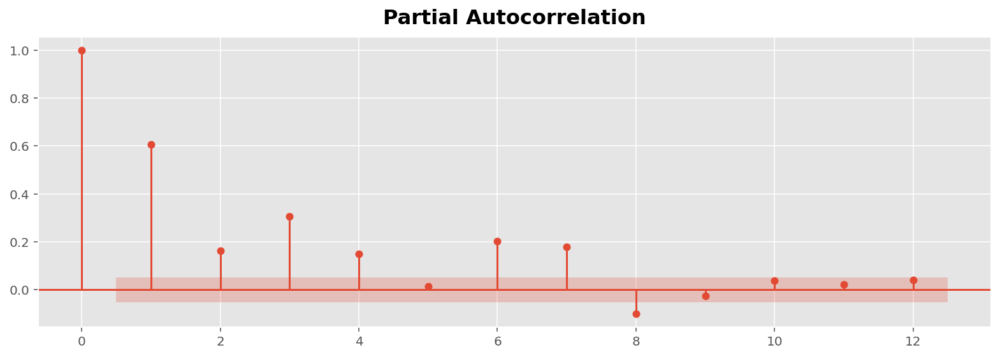

In [61]:
_ = plot_lags(df_daily.Global_active_power, lags=12, nrows=3)
_ = plot_pacf(df_daily.Global_active_power, lags=12)

### GAP has a slightly positive quadratic/cubic correlation between current GAP readings and past GAP readings
With a steady autocorrelation of 0.4 to 0.6 for most of the lag plots
Looking at the correlogram, the lags from 1 to 4 are all positive, indicating that they don't contribute much "new" correlation that the lag contributes.
_Since it's not linear, it won't be useful in forecasting 

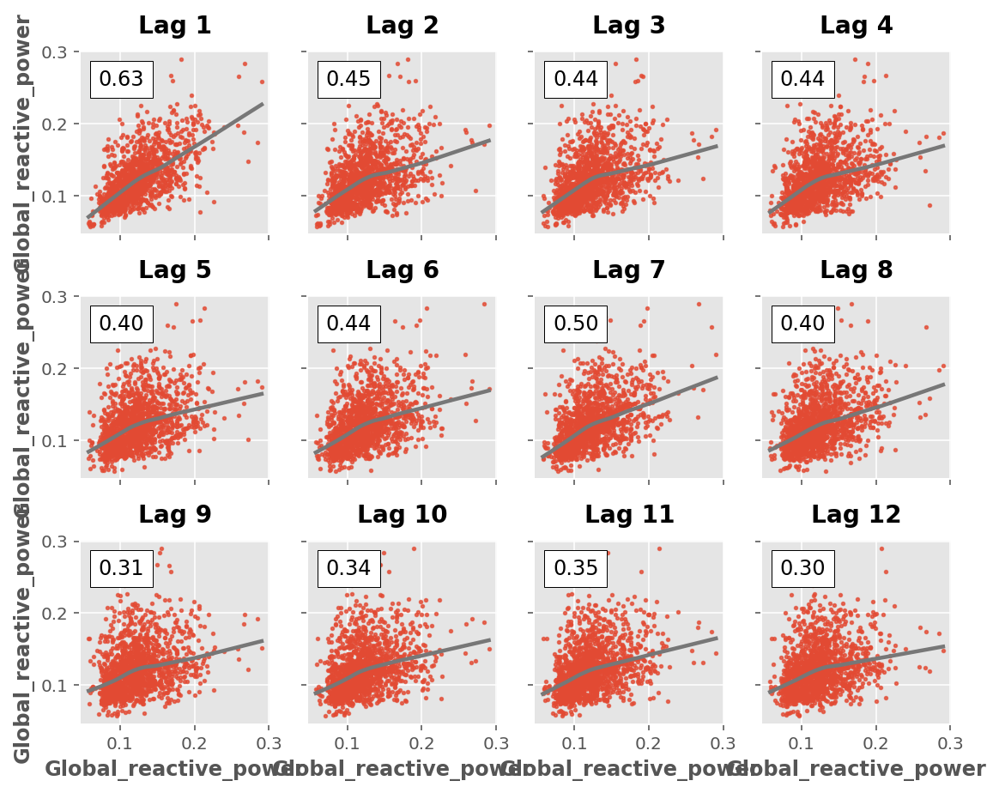

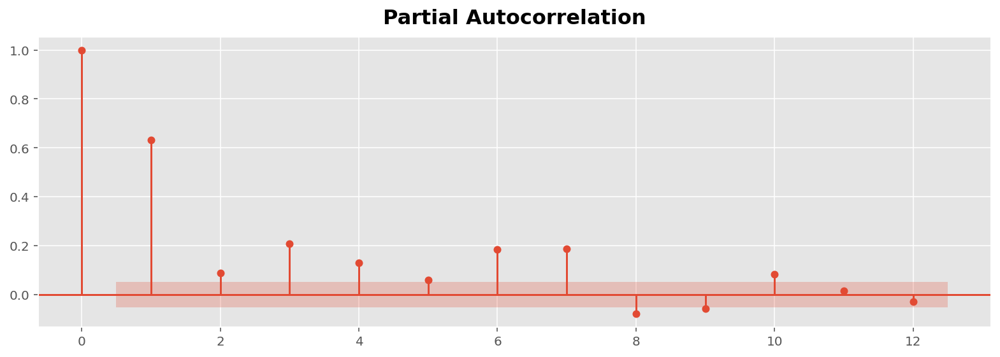

In [62]:
_ = plot_lags(df_daily.Global_reactive_power, lags=12, nrows=3)
_ = plot_pacf(df_daily.Global_reactive_power, lags=12)

This feature is very similar to GAP , so the analysis is the same

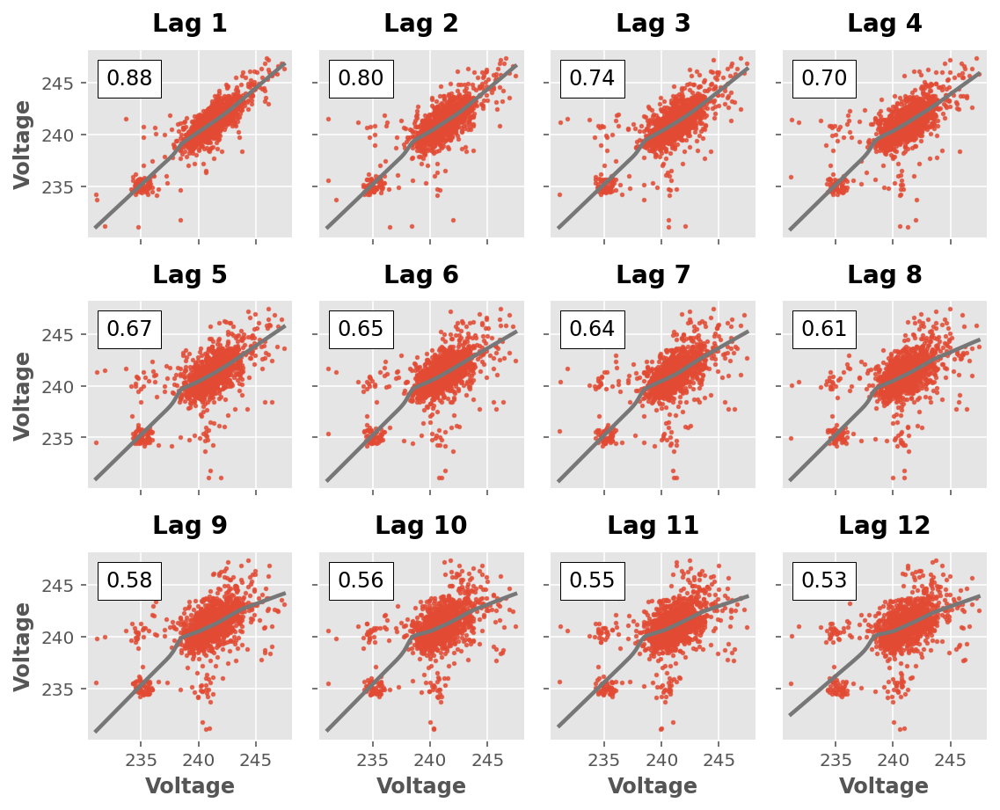

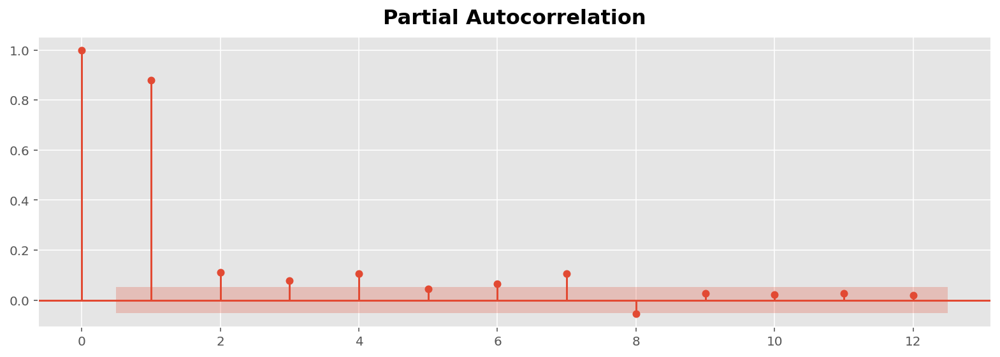

In [63]:
_ = plot_lags(df_daily.Voltage, lags=12, nrows=3)
_ = plot_pacf(df_daily.Voltage, lags=12)

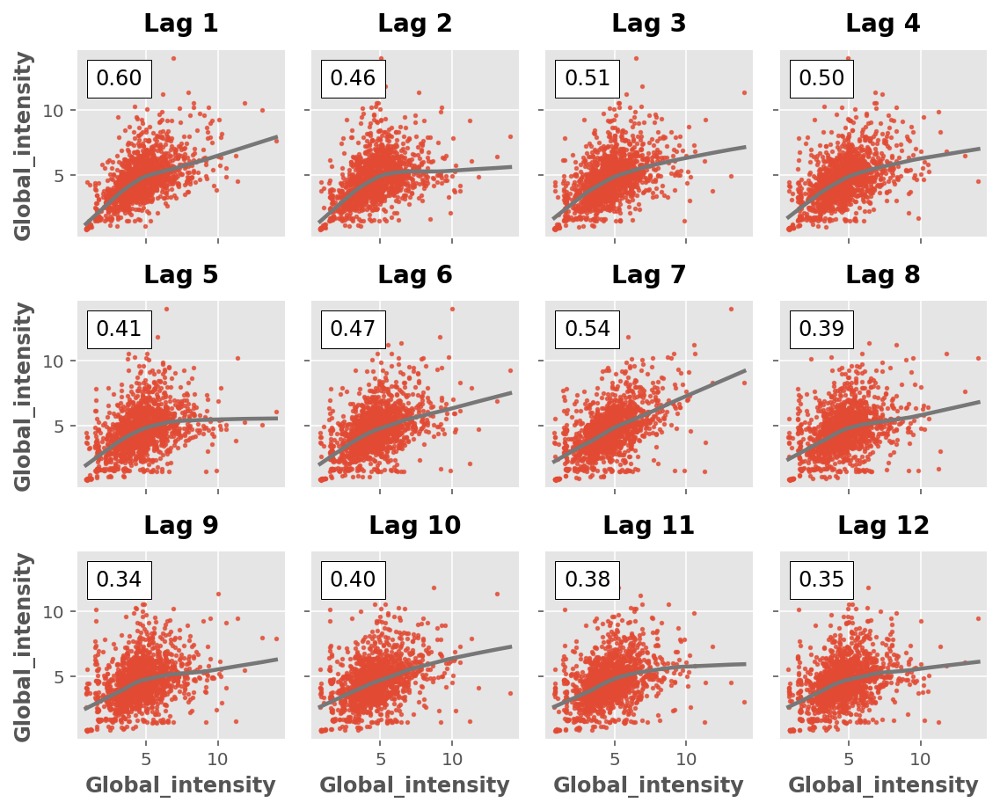

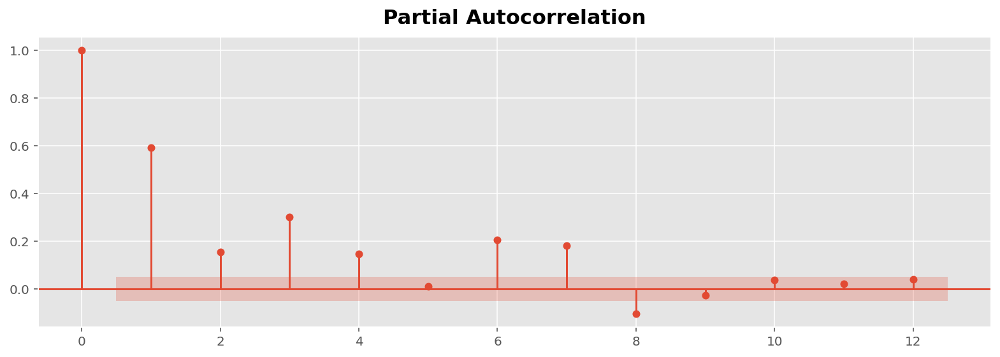

In [64]:
_ = plot_lags(df_daily.Global_intensity, lags=12, nrows=3)
_ = plot_pacf(df_daily.Global_intensity, lags=12)

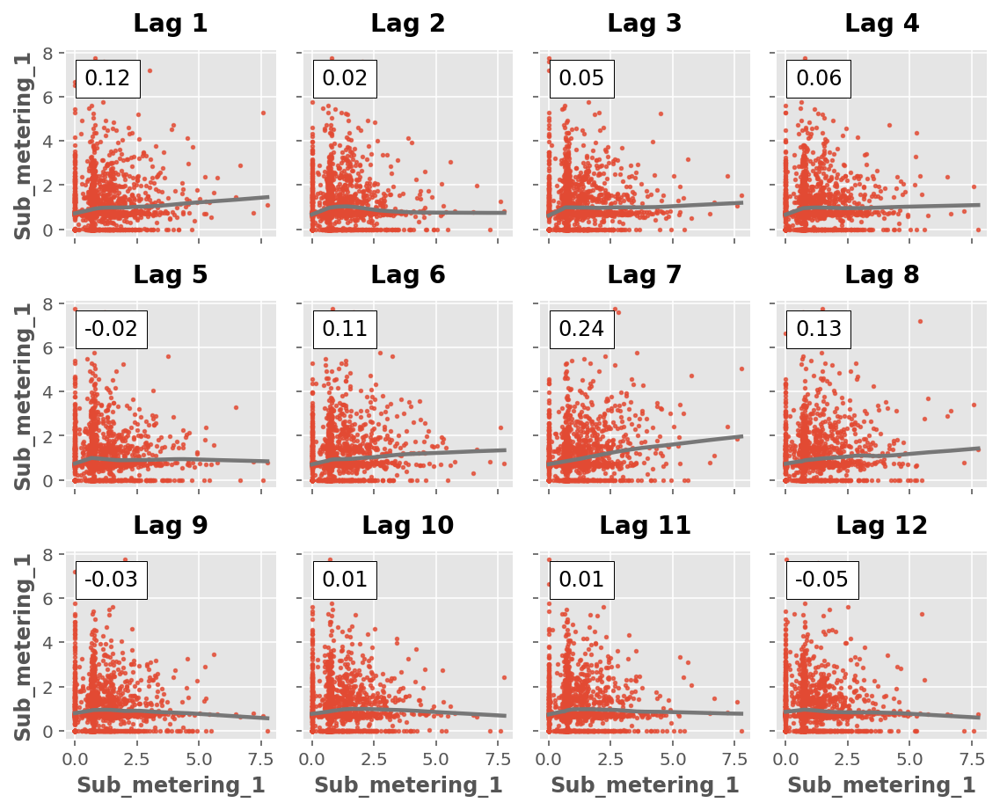

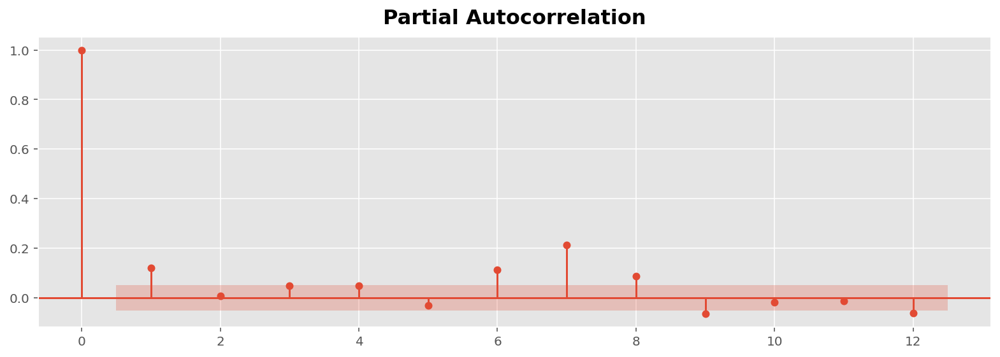

In [65]:
_ = plot_lags(df_daily.Sub_metering_1, lags=12, nrows=3)
_ = plot_pacf(df_daily.Sub_metering_1, lags=12)

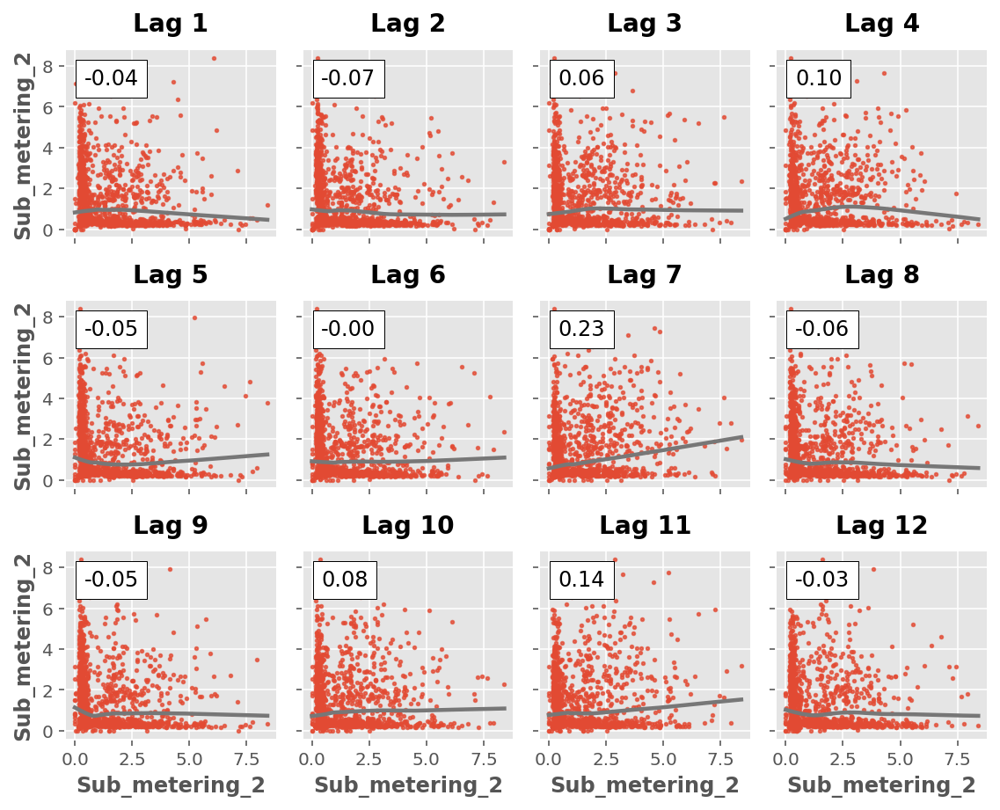

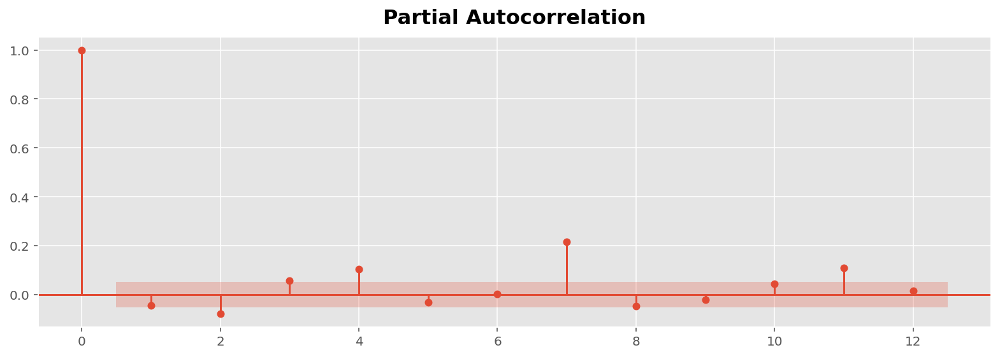

In [66]:
_ = plot_lags(df_daily.Sub_metering_2, lags=12, nrows=3)
_ = plot_pacf(df_daily.Sub_metering_2, lags=12)

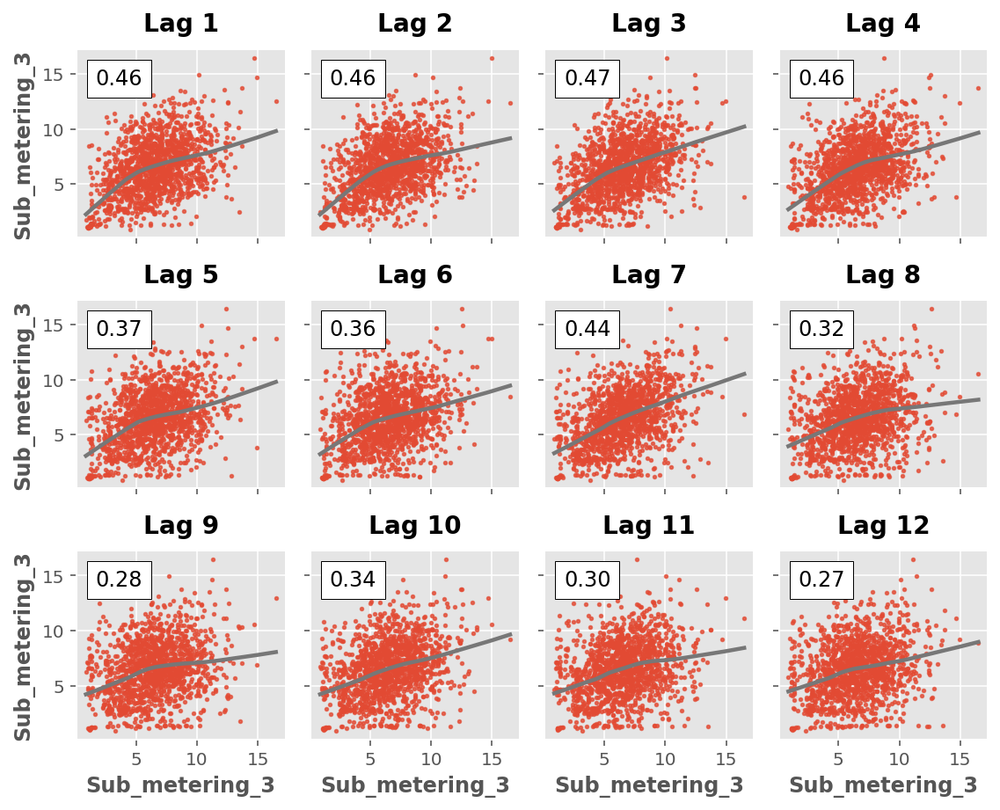

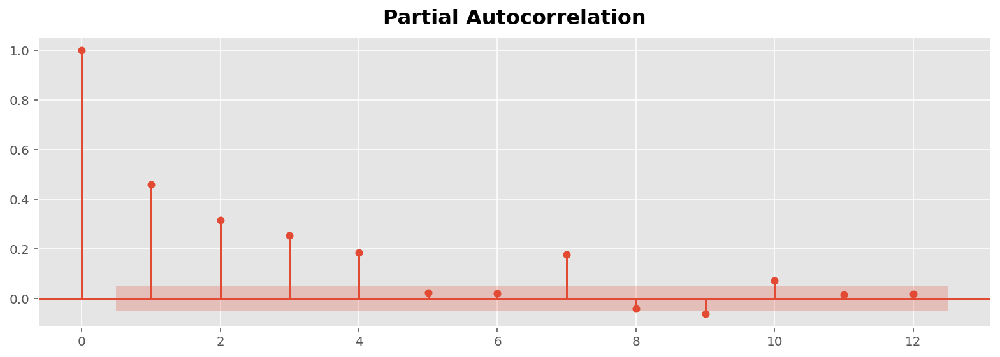

In [67]:
_ = plot_lags(df_daily.Sub_metering_3, lags=12, nrows=3)
_ = plot_pacf(df_daily.Sub_metering_3, lags=12)

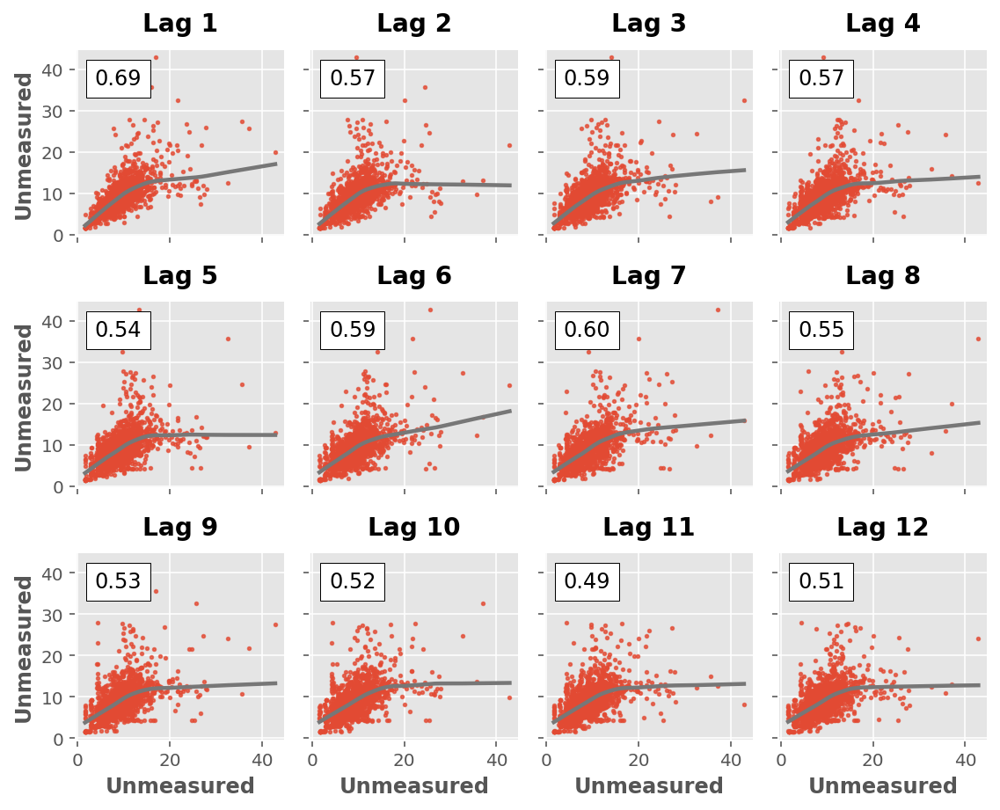

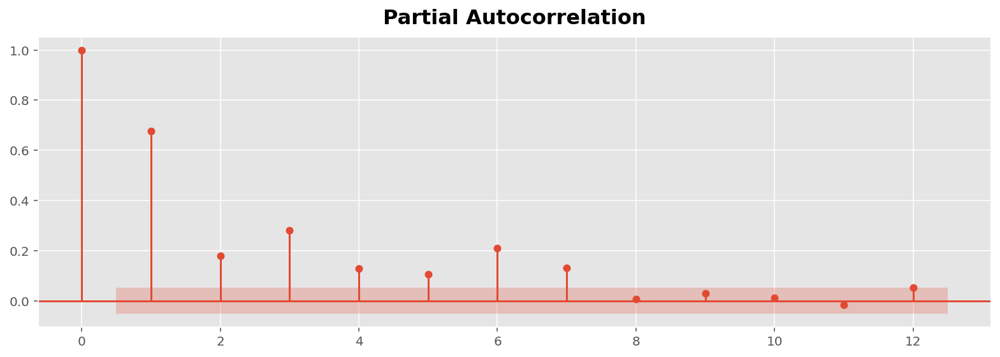

In [68]:
_ = plot_lags(df_daily.Unmeasured, lags=12, nrows=3)
_ = plot_pacf(df_daily.Unmeasured, lags=12)

# It looks like almost all the plots are non-linear, since autocorrelation is a measure of linear dependence, we can say that there is no clear Serial dependence. 
_We may need to remove seasonality/cycles in order to see if theres more Serial dependence_

<br> <br>
***
<br> <br>

# Next I'll be evaluating Seasonality, more specifically, if we can forecast based on seasonality

First implementing all the plotting functions

In [39]:
def seasonal_plot(X, y, period, freq, ax=None):
    if ax is None:
        _, ax = plt.subplots()
    palette = sns.color_palette(
        "husl",
        n_colors=X[period].nunique(),
    )
    ax = sns.lineplot(
        x=freq,
        y=y,
        hue=period,
        data=X,
        ci=False,
        ax=ax,
        palette=palette,
        legend=False,
    )
    ax.set_title(f"Seasonal Plot ({period}/{freq})")
    for line, name in zip(ax.lines, X[period].unique()):
        y_ = line.get_ydata()[-1]
        ax.annotate(
            name,
            xy=(1, y_),
            xytext=(6, 0),
            color=line.get_color(),
            xycoords=ax.get_yaxis_transform(),
            textcoords="offset points",
            size=14,
            va="center",
        )
    return ax


def plot_periodogram(ts, detrend="linear", ax=None):
    from scipy.signal import periodogram

    fs = pd.Timedelta("1Y") / pd.Timedelta("1D")
    freqencies, spectrum = periodogram(
        ts,
        fs=fs,
        detrend=detrend,
        window="boxcar",
        scaling="spectrum",
    )
    if ax is None:
        _, ax = plt.subplots()
    ax.step(freqencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([1, 2, 4, 6, 12, 26, 52, 104])
    ax.set_xticklabels(
        [
            "Annual (1)",
            "Semiannual (2)",
            "Quarterly (4)",
            "Bimonthly (6)",
            "Monthly (12)",
            "Biweekly (26)",
            "Weekly (52)",
            "Semiweekly (104)",
        ],
        rotation=30,
    )
    ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    ax.set_ylabel("Variance")
    ax.set_title("Periodogram")
    return ax


def seasonal_plot_all(target):
    X = df.copy()
    # days within a week
    X["minutes"] = X.index.minute
    X["hour"] = X.index.hour
    X["day"] = X.index.dayofweek  # the x-axis (freq)
    X["week"] = X.index.week  # the seasonal period (period)

    # days within a year
    X["dayofyear"] = X.index.dayofyear
    X["year"] = X.index.year
    fig, (ax0, ax1, ax2, ax3) = plt.subplots(4, 1, figsize=(15, 10))

    seasonal_plot(X, y=target, period="year", freq="dayofyear", ax=ax0)
    seasonal_plot(X, y=target, period="week", freq="day", ax=ax1)
    seasonal_plot(X, y=target, period="day", freq="hour", ax=ax2)
    seasonal_plot(X, y=target, period="hour", freq="minutes", ax=ax3)

    plot_periodogram(df_daily[target])

In [72]:
def seasonal_fourier_forecast(target, freqs, order):
    plt.rc("figure", autolayout=True, figsize=(20, 8))
    plt.rc(
        "axes",
        labelweight="bold",
        labelsize="large",
        titleweight="bold",
        titlesize=16,
        titlepad=10,
    )
    fourier = CalendarFourier(
        freq=freqs, order=order
    )  # 'order' pairs for 'freq' seasonality e.g. 50 pairs for 'A'nnual seasonality.

    dp = DeterministicProcess(
        index=df_daily.index,
        constant=True,  # dummy feature for bias (y-intercept)
        order=1,  # trend (order 1 means linear)
        seasonal=True,  # annual seasonality (indicators)
        additional_terms=[fourier],  # weekly seasonality (fourier)
        drop=True,  # drop terms to avoid collinearity
    )

    X = dp.in_sample()  # create features for dates in tunnel.index

    y = df_daily[target]

    model = LinearRegression(fit_intercept=False)
    _ = model.fit(X, y)

    y_pred = pd.Series(model.predict(X), index=y.index)
    X_fore = dp.out_of_sample(steps=365)
    y_fore = pd.Series(model.predict(X_fore), index=X_fore.index)

    ax = y.plot(color="0.25", style=".", title=target + " - Seasonal Forecast")
    ax = y_pred.plot(ax=ax, label="Seasonal", color="b")
    ax = y_fore.plot(ax=ax, label="Seasonal Forecast", color="g")
    _ = ax.legend()
    ax.set_ylabel(target)
    ax.set_xlabel("Time")

<br> <br>
***
<br> <br>

## Global Active Power

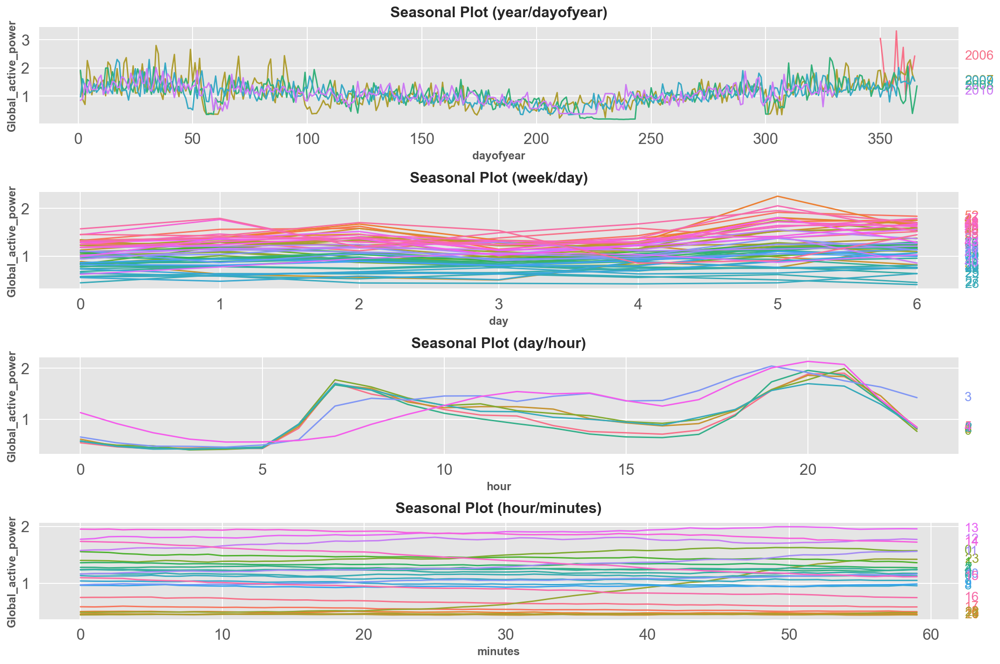

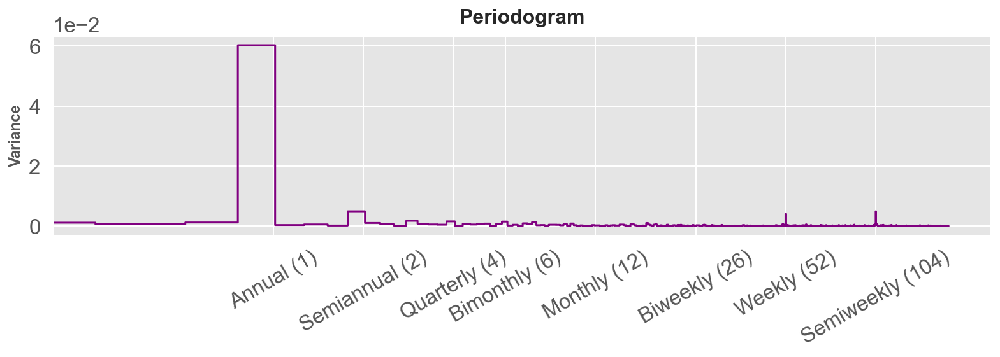

In [41]:
seasonal_plot_all("Global_active_power")

#### There is clear annual seasonal pattern, lower in the middle of the year and higher at the start and end. 
#### Furthermore, there is a clear daily pattern where there is high energy usage around 7-8am when people get up for work and 6-8pm when people cook at home.
#### The periodogram confirms that there is a strong annual season and a weaker weekly season

We will model the annual sseason with indicators and the annual season with fourier features. From right to left it drops off after weekly so I'll use 50 Fourier pairs.

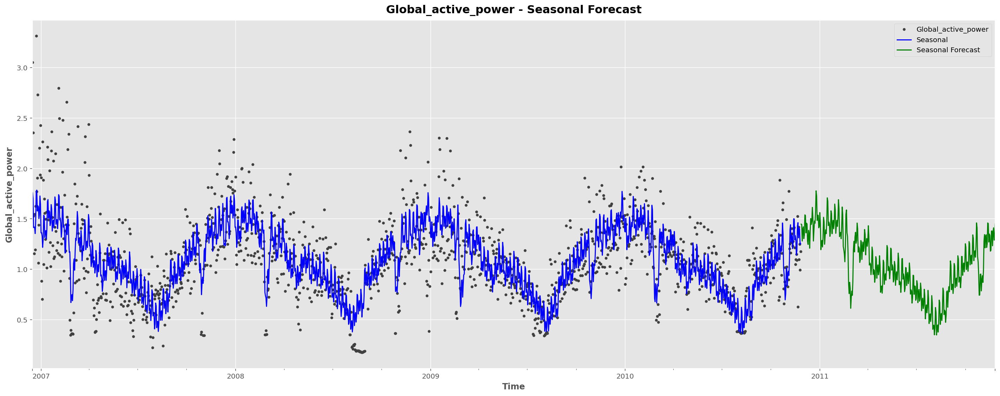

In [73]:
seasonal_fourier_forecast("Global_active_power", "A", 50)

## We can successfully forecast GAP based on seasonality with the help of fourier pairs.

#### Let's look at other features and see if we can do the same

<br> <br>
***
<br> <br>

## Global Reactive Power

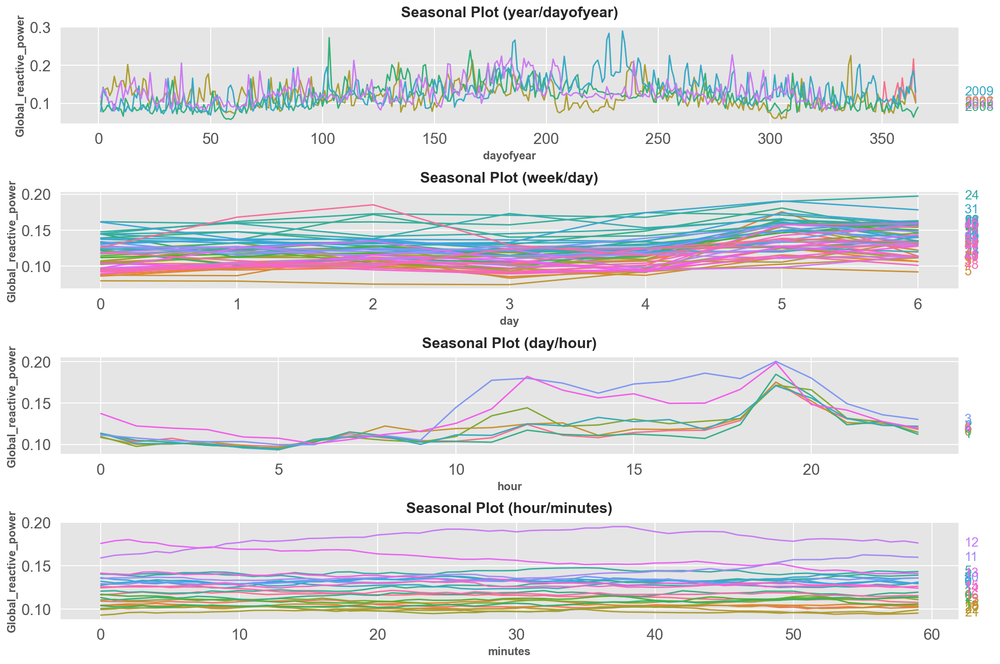

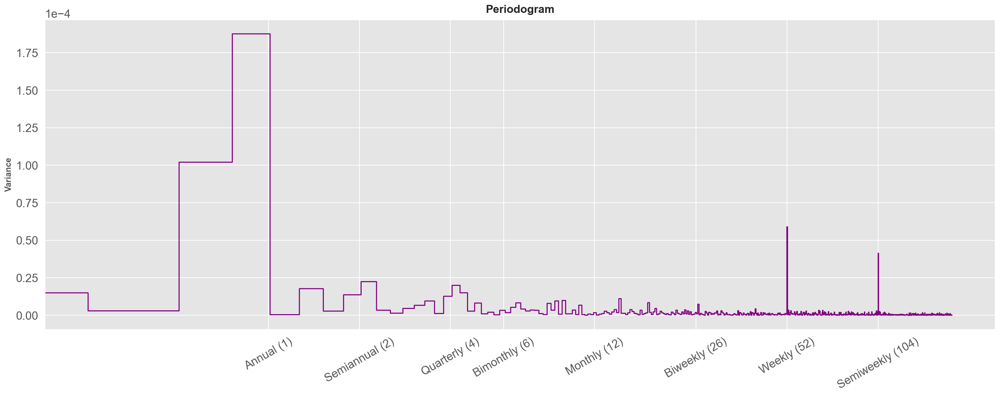

In [43]:
seasonal_plot_all("Global_reactive_power")

#### As expected, GRP should have somewhat an opposite trend of GAP with peaks in the middle of the year and dips at the start and ends.
#### Interestingly, there is a unavoidable trend in the day/hour graph, we can see that it peaks midday as people typically are not home at that time. However, it is interesting that it peaks around 6pm, a prime usage time. This may mean that the power company supplies more power during that time knowing it would be a peak time. We cannot infer much from the other plots other than the GRP is slightly higher on weekends.

#### Since we have a large annual peak in the periodogram like the same as GAP, we will try to fit with the same parameters as before.


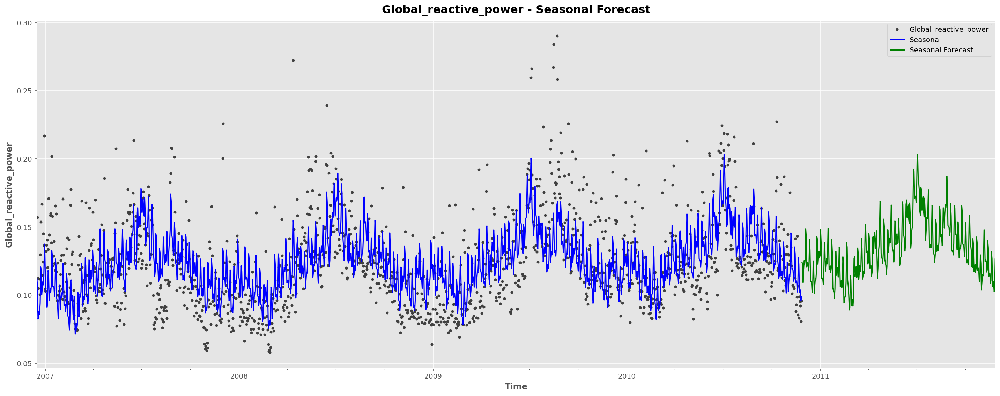

In [74]:
seasonal_fourier_forecast("Global_reactive_power", "A", 50)

<br> <br>
***
<br> <br>

## Voltage

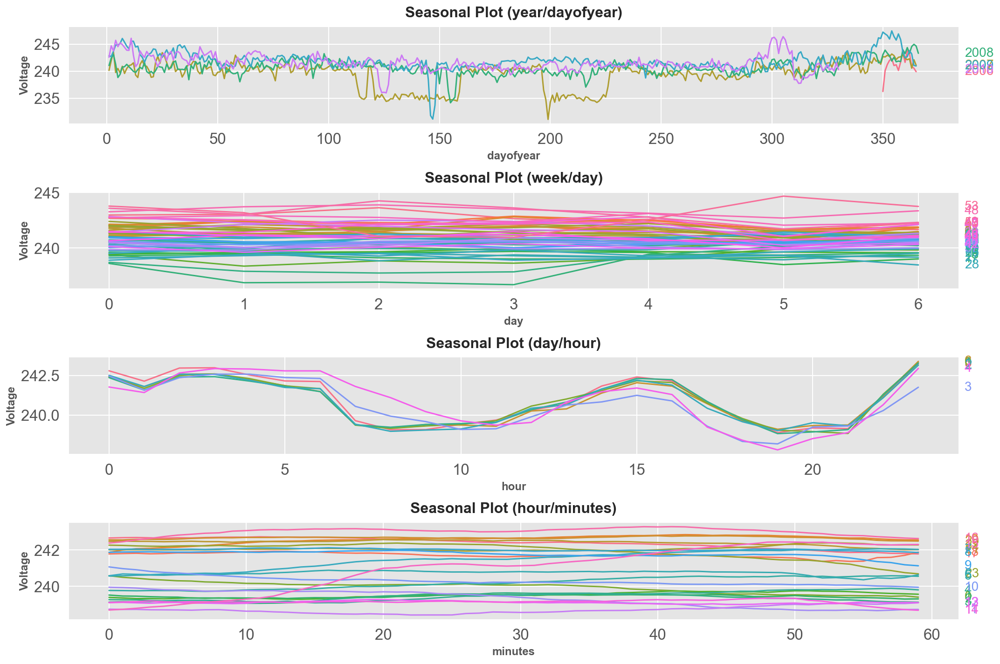

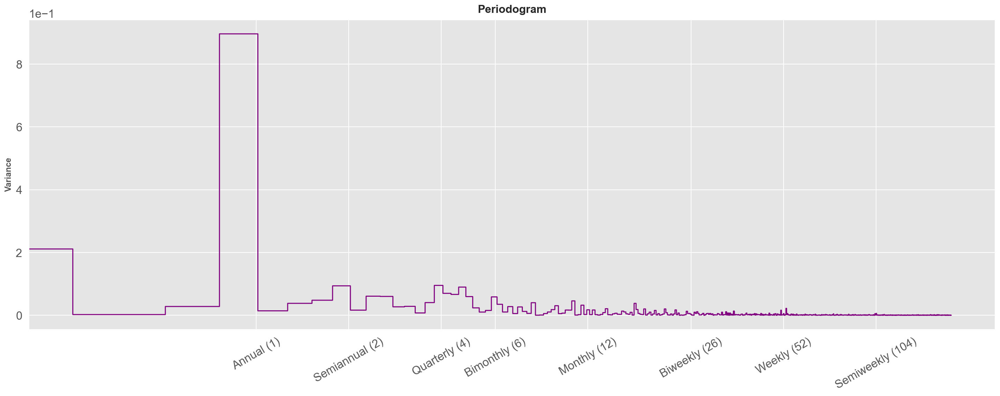

In [45]:
seasonal_plot_all("Voltage")

#### From our previous EDA, we couldn't infer much information from the Voltage column, but now we can see that there is indeed a pattern.
#### From the periodogram, we can see that it has a strong annual season even if it is non obvious from the seasonal plot. Furthermore, there seems to be a very clear daily voltage trend! 
We can try to capture the annual seasonality with assistance of fourier pairs on the daily seasonality.

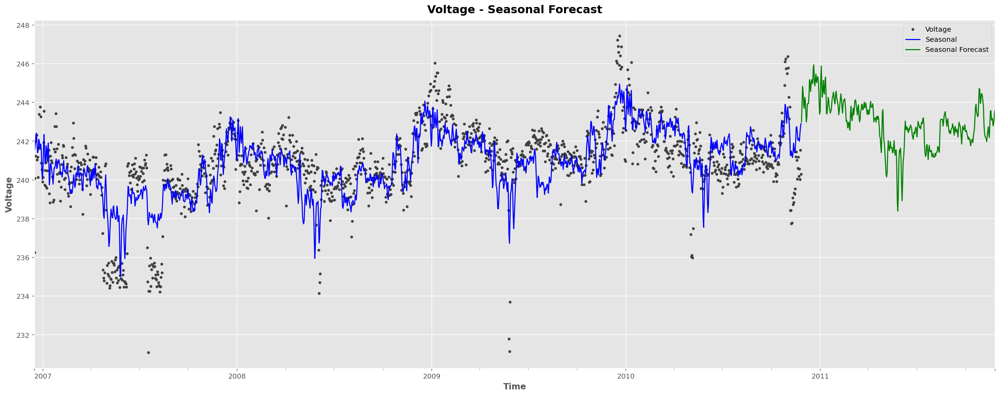

In [75]:
seasonal_fourier_forecast("Voltage", "A", 100)

The voltage trend seems to fit the seasonal forecast but the two dips in 2007-2008 may have skewed our data quite heavily which causes some mismatches in future predictions.

<br> <br>
***
<br> <br>
## Global Intensity

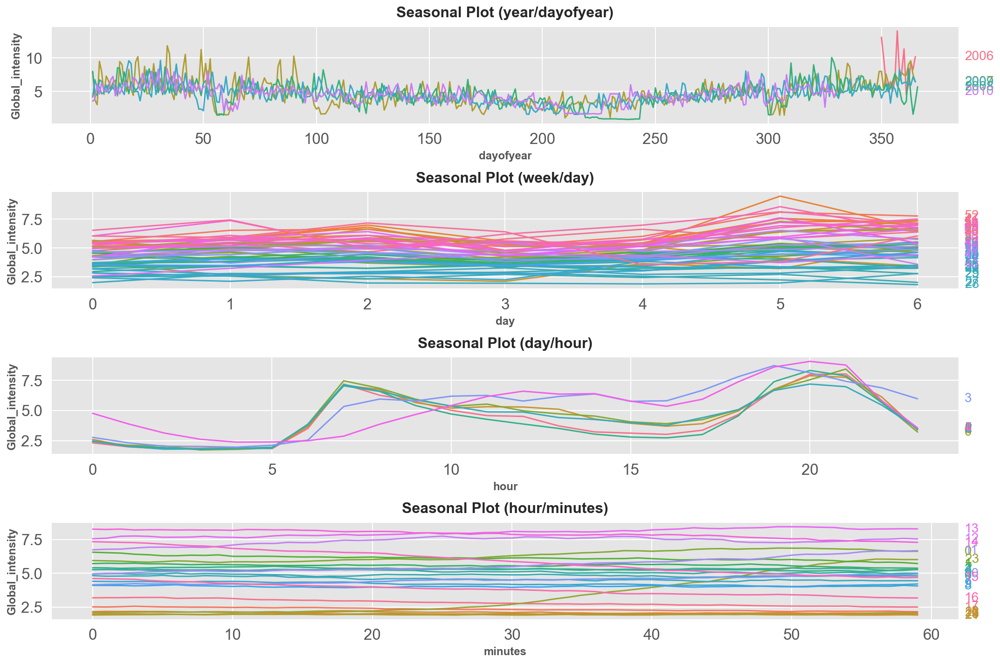

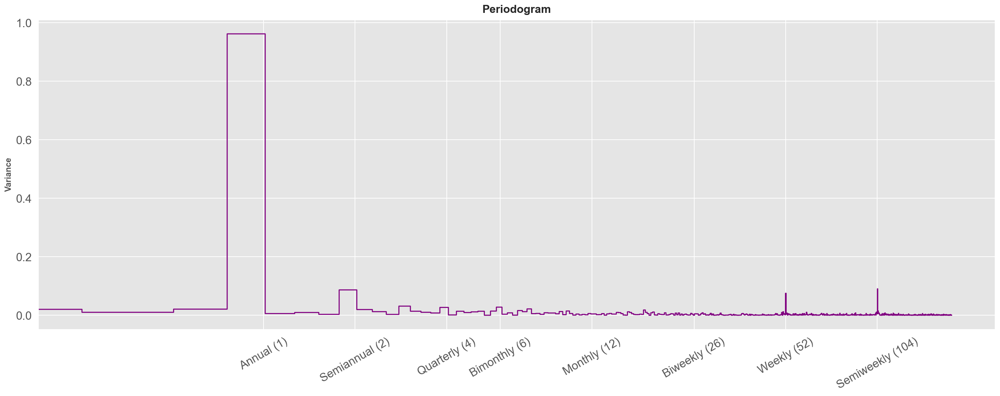

In [47]:
seasonal_plot_all("Global_intensity")

#### Surprisingly, we could see information we previously couldn't about the relationship between GI and voltage. Since we knew $Power = Voltage * Intensity$ , voltage has the complete opposite daily seasonal plot compared to GI, which is what we expected at the start but couldn't see.
#### Voltage is also strongly annual seasoned. The periodogram looks identical to GAP's, so we can do the same params for forecasting.

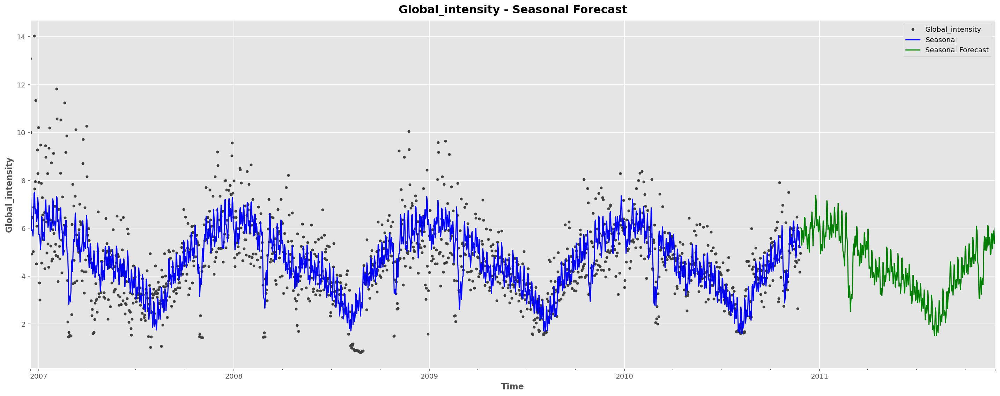

In [76]:
seasonal_fourier_forecast("Global_intensity", "A", 50)

<br> <br>
***
<br> <br>
## Sub Metering 1 (kitchen, containing mainly a dishwasher, an oven and a microwave)

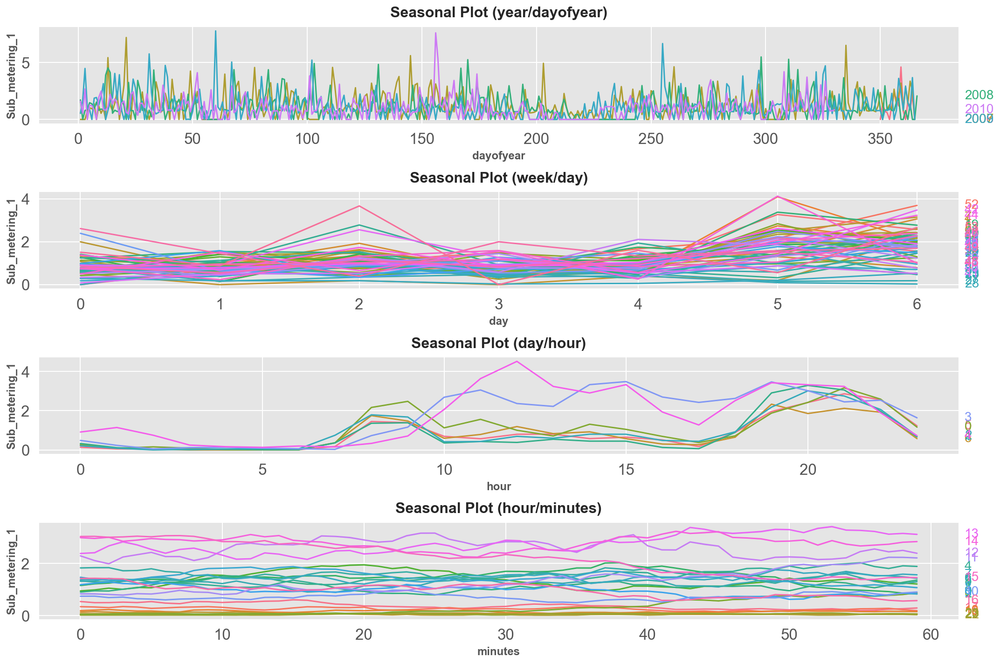

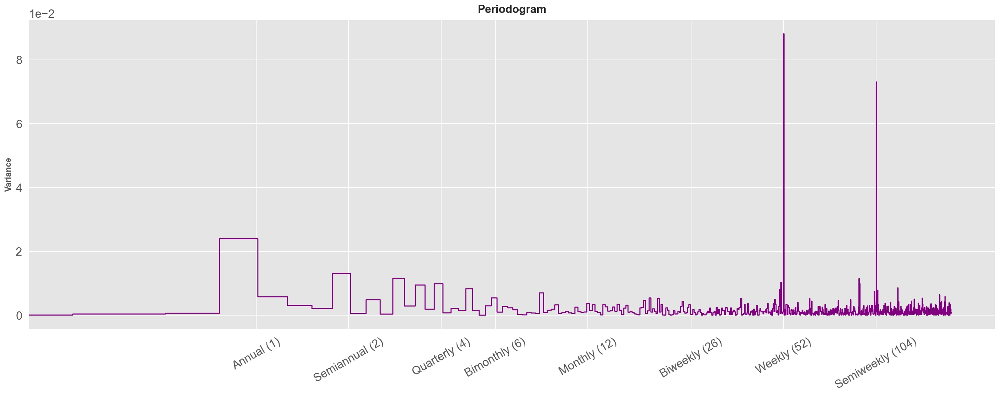

In [49]:
seasonal_plot_all("Sub_metering_1")

#### As expected, kitchen utility is strongly daily based, as we can see from the seasonal plots, only the day / hour plot shows any sort of trend, with usage in the morning and in the evening. The Periodogram shows strong weekly season and a weaker annual season. The Periodogram falls off between weekly and biweekly so I'll use 45 Fourier Pairs.

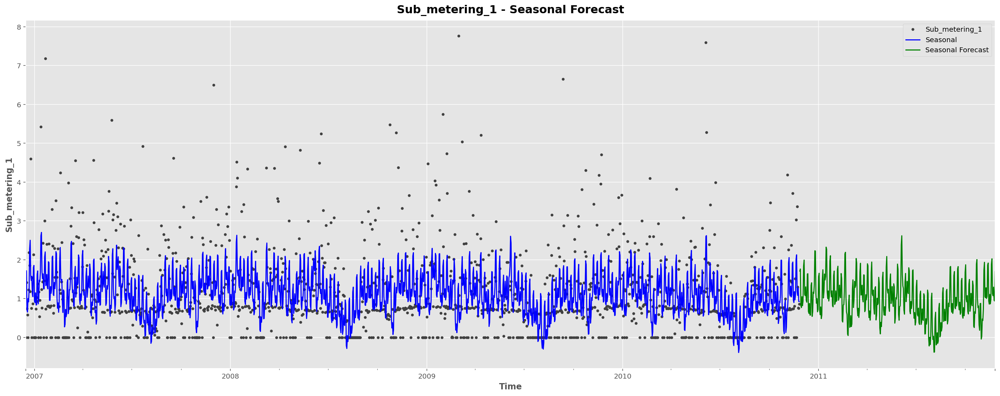

In [77]:
seasonal_fourier_forecast("Sub_metering_1", "A", 45)

#### Sub metering 1's data is so erratic that the forecast is finding it difficult to create a good trend. It may be more predictable if we included data from holidays/events where kitchen usage could spike. 

<br> <br>
***
<br> <br>
## Sub Metering 2  laundry room, containing a washing-machine, a tumble-drier, a refrigerator and a light.

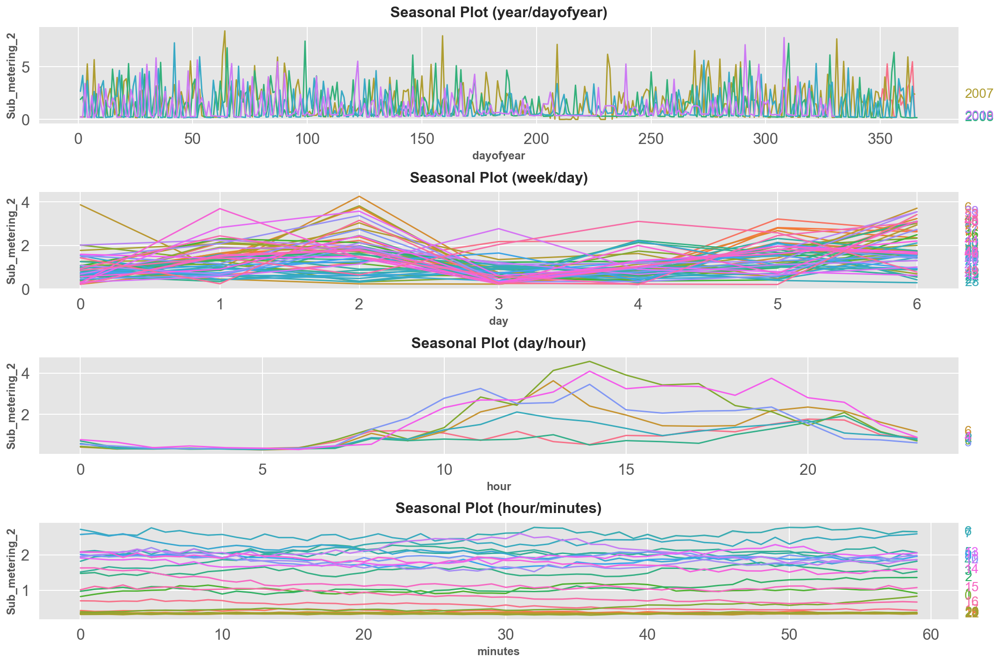

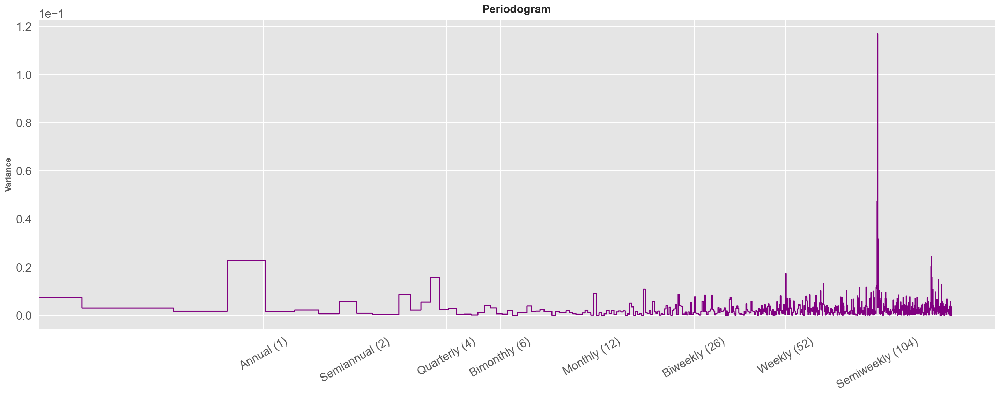

In [51]:
seasonal_plot_all("Sub_metering_2")

#### Interestingly Sub Metering 2 is heavily semi-weekly seasoned, which makes sense! Since the laundry is something that people do semi-weekly and not daily. Also, it seems that most peoplee do their laundry on a wednesday or the weekend.
#### There is weak annual seasonality since laundry is done frequently so we can do the forecast similarly to SM1

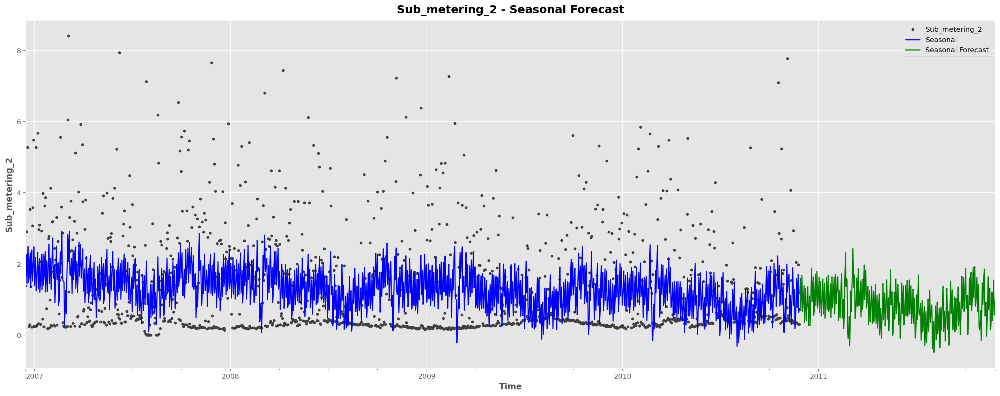

In [78]:
seasonal_fourier_forecast("Sub_metering_2", "A", 50)

<br> <br>
***
<br> <br>
## Sub Metering 3 (electric water-heater and an air-conditioner.)

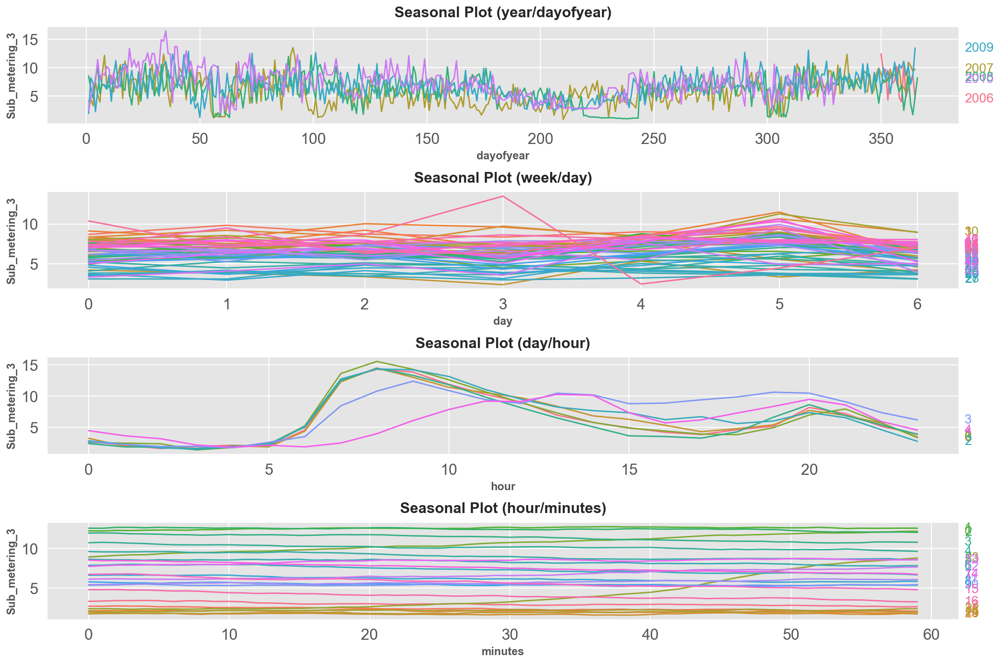

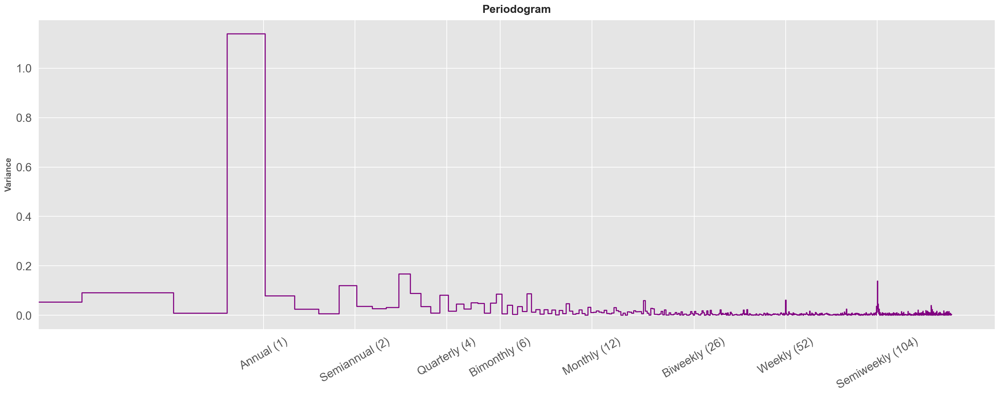

In [53]:
seasonal_plot_all("Sub_metering_3")

#### As expected SM3 is very annually seasonal since their usage depends on the seasons. Interestingly though, there is very high usage in the morning compared to night. Meaning that the people of this house probably take showers in the morning, using the water heater.

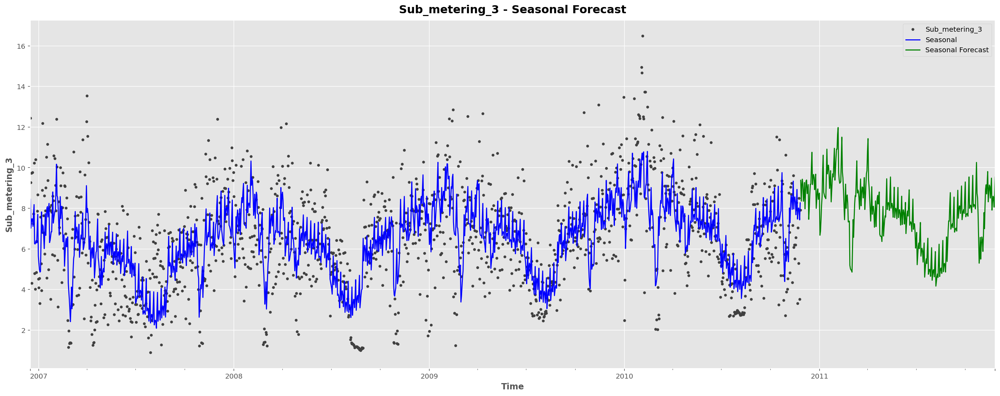

In [79]:
seasonal_fourier_forecast("Sub_metering_3", "A", 50)

<br> <br>
***
<br> <br>
## Unmeasured (Non-measured electric utility)

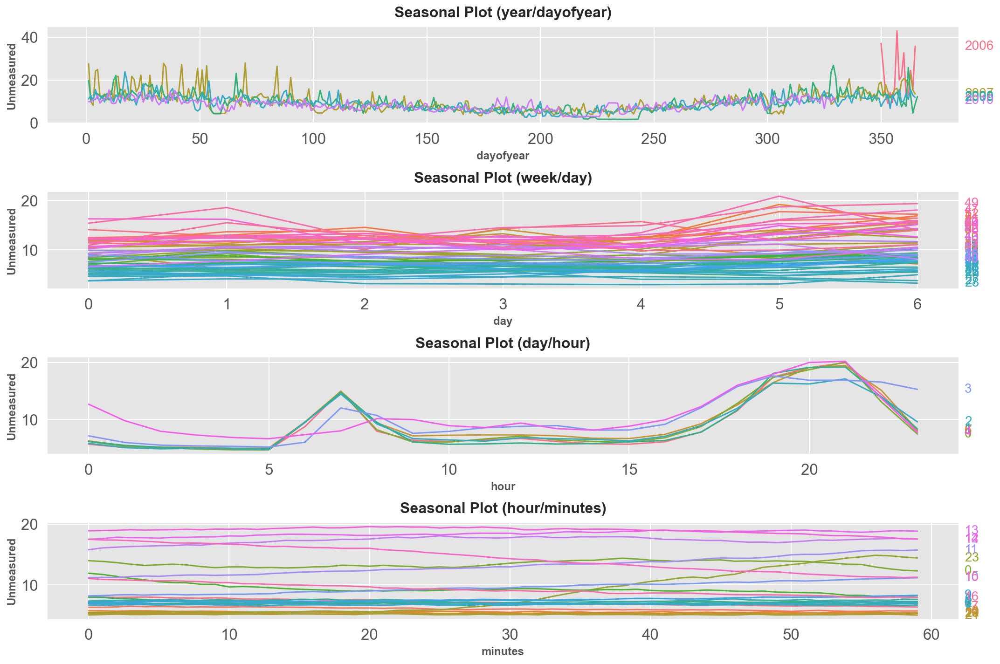

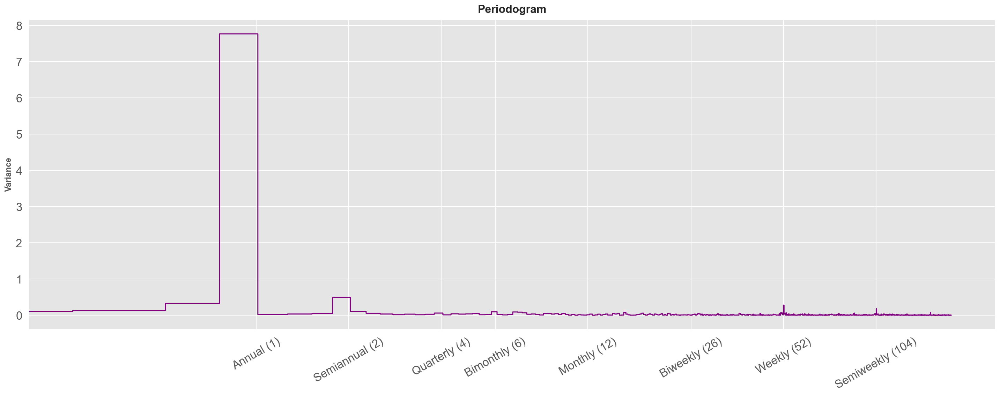

In [55]:
seasonal_plot_all("Unmeasured")

#### Surprisingly Unmeasured is annually seasoned. I would've thought that it would be weekly seasoned since it's power usage of utility that was not necessities,like TV, or phones at the time, or even computers. But we do see some daily seasonality in the morning and night like the kitchen utility. 
The annual seasonality might just be due to how strongly global active power is annually seasoned. Since this feature is a leftover of the sub metering, it's mostly from active power

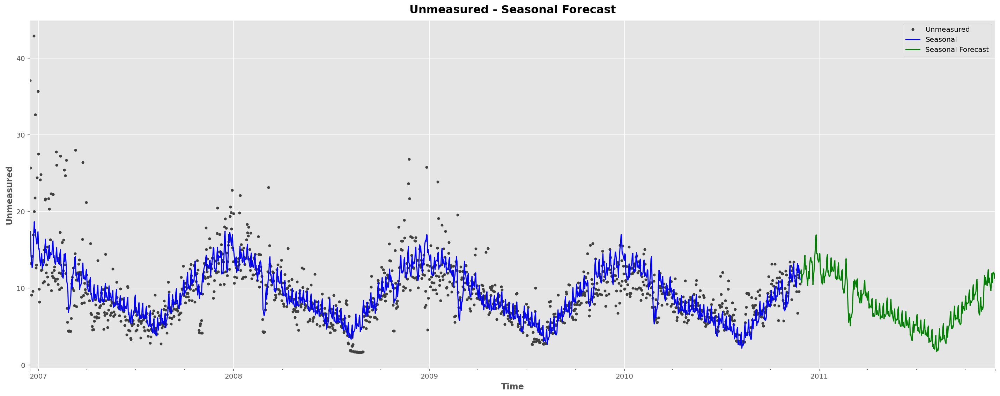

In [80]:
seasonal_fourier_forecast("Unmeasured", "A", 50)

<br> <br>
***
<br> <br>


# Forecasting with Machine Learning
## Firstly using Linear Regression and evaluating performance
Performance Evaluated as Mean absolute error (MAE) & Root mean square error (RMSE) : On average how far are our predictions from the true values
####  Forecasting focusing on GAP for time purposes as well as most variables are GAP dependent

Train RMSE: 0.35
Test RMSE: 0.27


Text(0.5, 0, 'Time')

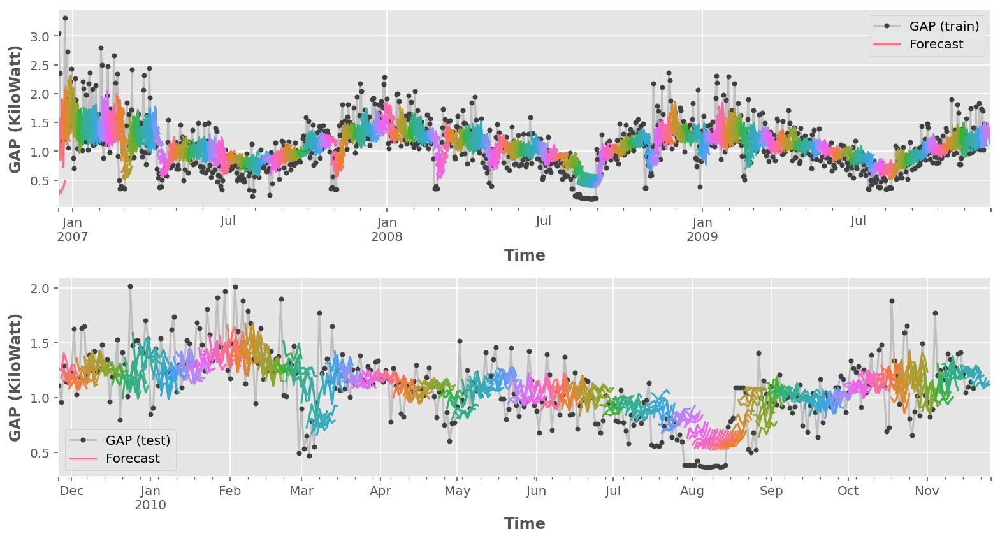

In [83]:
def plot_multistep(y, every=1, ax=None, palette_kwargs=None):
    palette_kwargs_ = dict(palette="husl", n_colors=16, desat=None)
    if palette_kwargs is not None:
        palette_kwargs_.update(palette_kwargs)
    palette = sns.color_palette(**palette_kwargs_)
    if ax is None:
        fig, ax = plt.subplots()
    ax.set_prop_cycle(plt.cycler("color", palette))
    for date, preds in y[::every].iterrows():
        preds.index = pd.period_range(start=date, periods=len(preds))
        preds.plot(ax=ax)
    return ax


def make_lags(ts, lags, lead_time=1):
    return pd.concat(
        {f"y_lag_{i}": ts.shift(i) for i in range(lead_time, lags + lead_time)}, axis=1
    )


y = df_daily.Global_active_power.copy()
X = make_lags(y, lags=4).fillna(0.0)


def make_multistep_target(ts, steps):
    return pd.concat({f"y_step_{i + 1}": ts.shift(-i) for i in range(steps)}, axis=1)


y = make_multistep_target(y, steps=8).dropna()

y, X = y.align(X, join="inner", axis=0)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, shuffle=False)

model = LinearRegression()
model.fit(X_train, y_train)

y_fit = pd.DataFrame(model.predict(X_train), index=X_train.index, columns=y.columns)
y_pred = pd.DataFrame(model.predict(X_test), index=X_test.index, columns=y.columns)
train_rmse = mean_squared_error(y_train, y_fit, squared=False)
test_rmse = mean_squared_error(y_test, y_pred, squared=False)
print((f"Train RMSE: {train_rmse:.2f}\n" f"Test RMSE: {test_rmse:.2f}"))

palette = dict(palette="husl", n_colors=64)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(11, 6))
ax1 = df_daily.Global_active_power[y_fit.index].plot(**plot_params, ax=ax1)
ax1 = plot_multistep(y_fit, ax=ax1, palette_kwargs=palette)
_ = ax1.legend(["GAP (train)", "Forecast"])
ax2 = df_daily.Global_active_power[y_pred.index].plot(**plot_params, ax=ax2)
ax2 = plot_multistep(y_pred, ax=ax2, palette_kwargs=palette)
_ = ax2.legend(["GAP (test)", "Forecast"])
ax1.set_ylabel('GAP (KiloWatt)')
ax2.set_ylabel('GAP (KiloWatt)')
ax1.set_xlabel("Time")
ax2.set_xlabel("Time")

## Linear Regression model is able to forecast decently well but having an RMSE of ~0.3 is pretty high, we are missing a lot of targets.
(Lower RMSE is better)

<br><br>
***
<br>

## Extreme Gradient Boosting (XG Boost Regression)

In [59]:
from sklearn.multioutput import MultiOutputRegressor, RegressorChain
from xgboost import XGBRegressor

# model = RegressorChain(XGBRegressor())
model = MultiOutputRegressor(XGBRegressor())
model.fit(X_train, y_train)

y_fit = pd.DataFrame(model.predict(X_train), index=X_train.index, columns=y.columns)
y_pred = pd.DataFrame(model.predict(X_test), index=X_test.index, columns=y.columns)

Train RMSE: 0.35
Test RMSE: 0.27


Text(0.5, 0, 'Time')

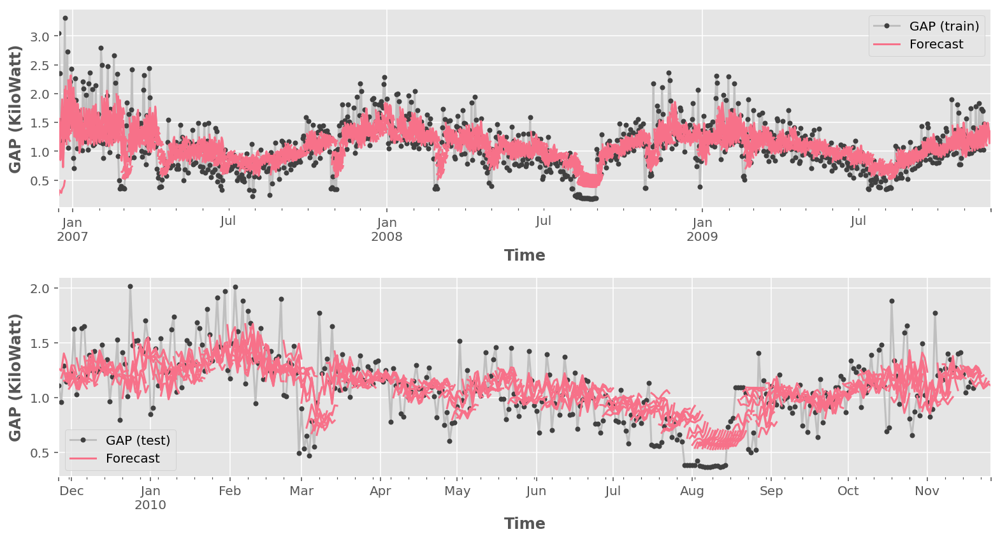

In [84]:
train_rmse = mean_squared_error(y_train, y_fit, squared=False)
test_rmse = mean_squared_error(y_test, y_pred, squared=False)
print((f"Train RMSE: {train_rmse:.2f}\n" f"Test RMSE: {test_rmse:.2f}"))

palette = dict(palette="husl", n_colors=1)
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(11, 6))
ax1 = df_daily.Global_active_power[y_fit.index].plot(**plot_params, ax=ax1)
ax1 = plot_multistep(y_fit, ax=ax1, palette_kwargs=palette)
_ = ax1.legend(["GAP (train)", "Forecast"])
ax2 = df_daily.Global_active_power[y_pred.index].plot(**plot_params, ax=ax2)
ax2 = plot_multistep(y_pred, ax=ax2, palette_kwargs=palette)
_ = ax2.legend(["GAP (test)", "Forecast"])
ax1.set_ylabel('GAP (KiloWatt)')
ax2.set_ylabel('GAP (KiloWatt)')
ax1.set_xlabel("Time")
ax2.set_xlabel("Time")

## On the training data, we only have RMSE of 0.06, which isn't bad, but the test RMSE (the RMSE that we care about) is only slightly lower than Linear Regression. This value is too high, so it's possible that Regression models will not be effective enough for forecasting our data.
<br><br>
***
<br>

# Long Short Term Memory (LSTM)
# Good for time series

Multi-layered LSTM Recurrent neural network(RNN) used to predict the last value of a sequence of values.
- LSTM is better than RNN since there are more options and tuning availabe
- LSTM is better than GRU in this case since we have a large dataset
- LSTM learns from multiple input time steps with one time step as output\
That's why we will make multiple lags from our data and train our model on it.\
I'll try using minutes then use hours to see the difference.

In [35]:
class LSTM:
    def __init__(self, data):
        self.data = np.reshape(data, (-1, 1))

    def scale_data(self, scaler=MinMaxScaler(feature_range=(0, 1))):
        self.scaler = scaler
        self.data = scaler.fit_transform(self.data)

    def split_data(self, split=0.75):
        train_len = int(len(self.data) * split)
        test_len = len(self.data) - train_len
        self.train, self.test = (
            self.data[0:train_len, :],
            self.data[train_len : len(self.data), :],
        )
        return self.train, self.test

    def make_lags(self, list_of_data, lags, lead_time=1):
        return pd.concat(
            {f"y_step_{i + 1}": list_of_data.shift(-i) for i in range(lags)}, axis=1
        )

    def xy_split(self, data_to_split):
        return np.array(data_to_split.iloc[:, :-1]), np.array(data_to_split.iloc[:, -1])

    def reshape_to_3(self, data_to_reshape):
        return np.reshape(
            data_to_reshape, (data_to_reshape.shape[0], 1, data_to_reshape.shape[1])
        )

    def store_values(self, x_train, x_test, y_train, y_test):
        self.x_train = x_train
        self.x_test = x_test
        self.y_train = y_train
        self.y_test = y_test

    def create_model(self, LSTM_neurons=100, dropout_percent=0.2):
        self.model = keras.Sequential()
        self.model.add(
            layers.LSTM(
                LSTM_neurons, input_shape=(self.x_train.shape[1], self.x_train.shape[2])
            )
        )
        self.model.add(layers.Dropout(dropout_percent))
        self.model.add(layers.Dense(1))
        self.model.compile(loss="mean_squared_error", optimizer="adam")

    def fit_model(
        self,
        epochs,
        batch_size,
    ):
        self.history = self.model.fit(
            self.x_train,
            self.y_train,
            epochs=epochs,
            batch_size=batch_size,
            validation_data=(self.x_test, self.y_test),
            callbacks=[keras.callbacks.EarlyStopping(monitor="val_loss", patience=10)],
            verbose=1,
            shuffle=False,
        )

        print(self.model.summary())

    def predict_evaluate(self):
        self.train_predict = self.model.predict(self.x_train)
        self.test_predict = self.model.predict(self.x_test)
        # invert predictions back to previous values
        self.train_predict = self.scaler.inverse_transform(self.train_predict)
        self.y_train = self.scaler.inverse_transform([self.y_train.T])
        self.test_predict = self.scaler.inverse_transform(self.test_predict)
        self.y_test = self.scaler.inverse_transform([self.y_test.T])

        mae = mean_absolute_error(self.y_train[0], self.train_predict[:, 0])
        rmse = np.sqrt(mean_squared_error(self.y_train[0], self.train_predict[:, 0]))
        tmse = mean_absolute_error(self.y_test[0], self.test_predict[:, 0])
        trmse = np.sqrt(mean_squared_error(self.y_test[0], self.test_predict[:, 0]))

        print("Train Mean Absolute Error: %.3f" % mae)
        print("Train Root Mean Squared Error: %.3f" % rmse)
        print("Test Mean Absolute Error: %.3f" % tmse)
        print("Test Root Mean Squared Error: %.3f" % trmse)

    def plot_loss(self):

        plt.plot(self.history.history["loss"], color="r", label="Training Loss")
        plt.plot(self.history.history["val_loss"], color="b", label="Validation Loss")
        plt.title("Training and validation loss")
        plt.ylabel("loss")
        plt.xlabel("epochs")
        plt.legend(loc=0)
        plt.show()

    def plot_graph(self, timestep, window_start, window_end, data_col_name, units):

        time_range = [i for i in range(timestep)]
        plt.figure(figsize=(8, 4))
        plt.plot(
            time_range,
            self.y_test[0][window_start:window_end],
            color="b",
            marker=".",
            label="Reality",
        )
        plt.plot(
            time_range,
            self.test_predict[:, 0][window_start:window_end],
            "r",
            label="Prediction",
        )
        # plt.tick_params(left=False, labelleft=True) #remove ticks
        plt.tight_layout()
        sns.despine(top=True)
        plt.subplots_adjust(left=0.07)
        plt.ylabel(data_col_name, size=15)
        plt.xlabel(
            ("Time step for " + units, window_start, " to ", window_end), size=15
        )
        plt.legend(fontsize=15)
        plt.show()

## Setting up Data for modelling

In [36]:
LSTM1 = LSTM(df.Global_active_power.values)
LSTM1.scale_data()
train, test = LSTM1.split_data()
train_lag = LSTM1.make_lags(pd.DataFrame(train), 50).dropna()
test_lag = LSTM1.make_lags(pd.DataFrame(test), 50).dropna()
x_train, y_train = LSTM1.xy_split(train_lag)
x_test, y_test = LSTM1.xy_split(test_lag)
x_train = LSTM1.reshape_to_3(x_train)
x_test = LSTM1.reshape_to_3(x_test)
LSTM1.store_values(x_train, x_test, y_train, y_test)

## Creating and fitting model

In [42]:
LSTM1.create_model(200, 0.2)
LSTM1.fit_model(50, 50)

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Train on 1556395 samples, validate on 518766 samples
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Epoch 1/50
1556395/1556395 [==============================] - 118s 76us/sample - loss: 8.1336e-04 - val_loss: 4.1653e-04
Epoch 2/50
1556395/1556395 [==============================] - 119s 76us/sample - loss: 6.9458e-04 - val_loss: 4.0402e-04
Epoch 3/50
1556395/1556395 [==============================] - 116s 74us/sample - loss: 6.7235e-04 - val_loss: 4.0744e-04
Epoch 4/50
1556395/1556395 [==============================] - 117s 75us/sample - loss: 6.6000e-04 - val_loss: 4.0071e-04
Epoch 5/50
1556395/1556395 [==============================] - 117s 75us/sample - loss: 6.5320e-04 - val_loss: 4.0283e-04
Epoch 6/50
1556395/1556395 [==============================] - 111s 72us/sample - loss: 6.4798e-04 - val_loss: 4.0142e-04
Epoch 7/5

## Predicting and evaluating loss/ "accuracy"

Train Mean Absolute Error: 0.097
Train Root Mean Squared Error: 0.256
Test Mean Absolute Error: 0.081
Test Root Mean Squared Error: 0.217


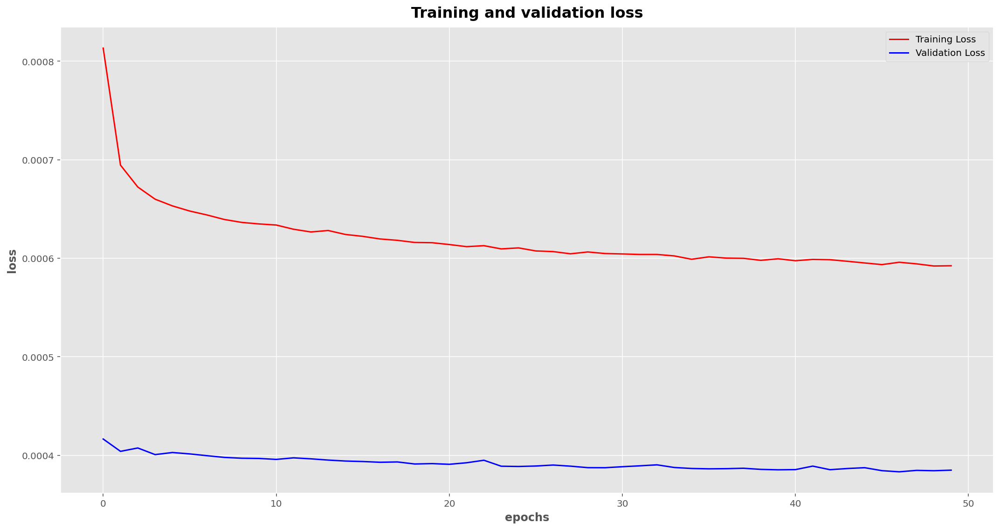

In [43]:
LSTM1.predict_evaluate()
LSTM1.plot_loss()

#### We can see that our MAE and RMSE are very low, so this model is pretty accurate! We can use this model to forecast if we wanted to.
#### It could be further improved with higher epochs and smaller batches but I'm not waiting days for results.

## Plotting the actual data and the predicted data on the same graph

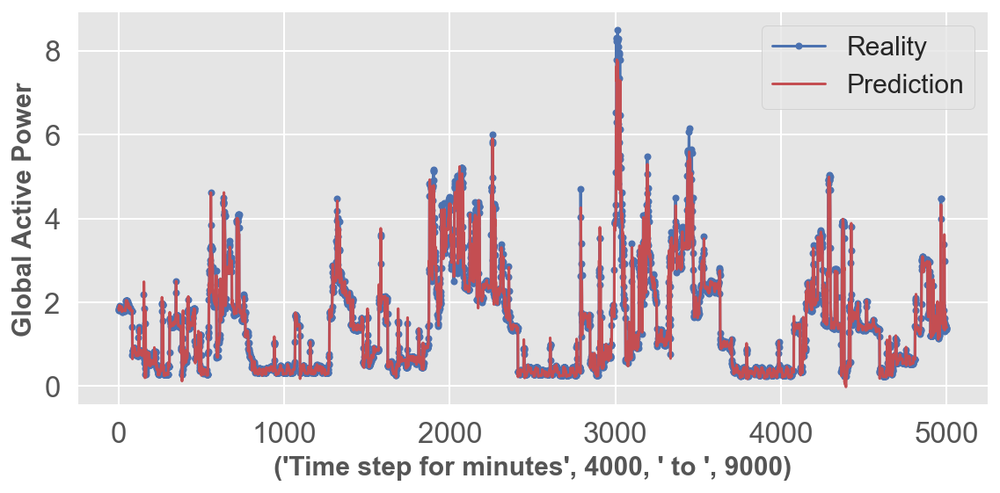

In [430]:
LSTM1.plot_graph(5000, 4000, 9000, "Global Active Power", "minutes")

In [ ]:
# e.) forecast with an LSTM,
def forecast_lstm(model, X, n_batch):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, len(X))
    # make forecast
    forecast = model.predict(X, batch_size=n_batch)
    # convert to array
    return [x for x in forecast[0, :]]


# f.)  evaluate the persistence model
def make_forecasts(model, n_batch, train, test, n_lag, n_seq):
    forecasts = list()
    for i in range(len(test)):
        X, y = test[i, 0:n_lag], test[i, n_lag:]
        # make forecast
        forecast = forecast_lstm(model, X, n_batch)
        # store the forecast
        forecasts.append(forecast)
    return forecasts


# g.) invert differenced forecast
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i - 1])
    return inverted


# h.) inverse data transform on forecasts
def inverse_transform(series, forecasts, scaler, n_test):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = array(forecasts[i])
        forecast = forecast.reshape(1, len(forecast))
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted


# i.) evaluate the model with RMSE
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        print("t+%d RMSE: %f" % ((i + 1), rmse))


# j.) plot the forecasts
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    pyplot.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        pyplot.plot(xaxis, yaxis, color="red")
    # show the plot
    pyplot.show()

<br><br>
***
<br><br>
# Hourly prediction model 

In [422]:
LSTM2 = LSTM(df_hourly.Global_active_power.values)
LSTM2.scale_data()
train, test = LSTM2.split_data()
train_lag = LSTM2.make_lags(pd.DataFrame(train), 30).dropna()
test_lag = LSTM2.make_lags(pd.DataFrame(test), 30).dropna()
x_train, y_train = LSTM2.xy_split(train_lag)
x_test, y_test = LSTM2.xy_split(test_lag)
x_train = LSTM2.reshape_to_3(x_train)
x_test = LSTM2.reshape_to_3(x_test)
LSTM2.store_values(x_train, x_test, y_train, y_test)

In [423]:
LSTM2.create_model(200, 0.2)
LSTM2.fit_model(20, 100)

Train on 25912 samples, validate on 8619 samples
Epoch 1/20
25912/25912 [==============================] - 6s 230us/sample - loss: 0.0122 - val_loss: 0.0072
Epoch 2/20
25912/25912 [==============================] - 3s 97us/sample - loss: 0.0092 - val_loss: 0.0070
Epoch 3/20
25912/25912 [==============================] - 2s 95us/sample - loss: 0.0090 - val_loss: 0.0070
Epoch 4/20
25912/25912 [==============================] - 2s 93us/sample - loss: 0.0089 - val_loss: 0.0070
Epoch 5/20
25912/25912 [==============================] - 2s 92us/sample - loss: 0.0089 - val_loss: 0.0069
Epoch 6/20
25912/25912 [==============================] - 2s 93us/sample - loss: 0.0089 - val_loss: 0.0069
Epoch 7/20
25912/25912 [==============================] - 3s 101us/sample - loss: 0.0088 - val_loss: 0.0069
Epoch 8/20
25912/25912 [==============================] - 3s 100us/sample - loss: 0.0087 - val_loss: 0.0069
Epoch 9/20
25912/25912 [==============================] - 2s 93us/sample - loss: 0.0087 - va

Train Mean Absolute Error: 0.434
Train Root Mean Squared Error: 0.599
Test Mean Absolute Error: 0.390
Test Root Mean Squared Error: 0.530


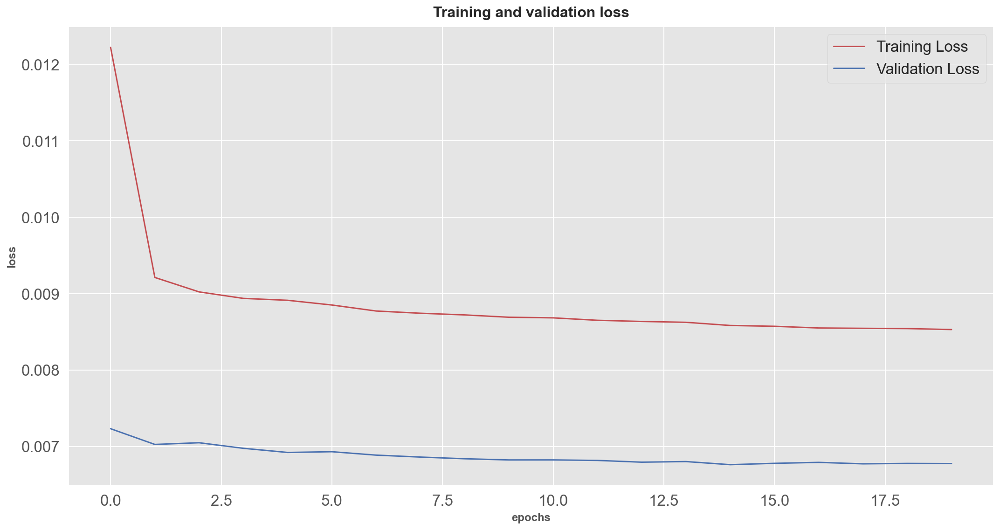

In [424]:
LSTM2.predict_evaluate()
LSTM2.plot_loss()

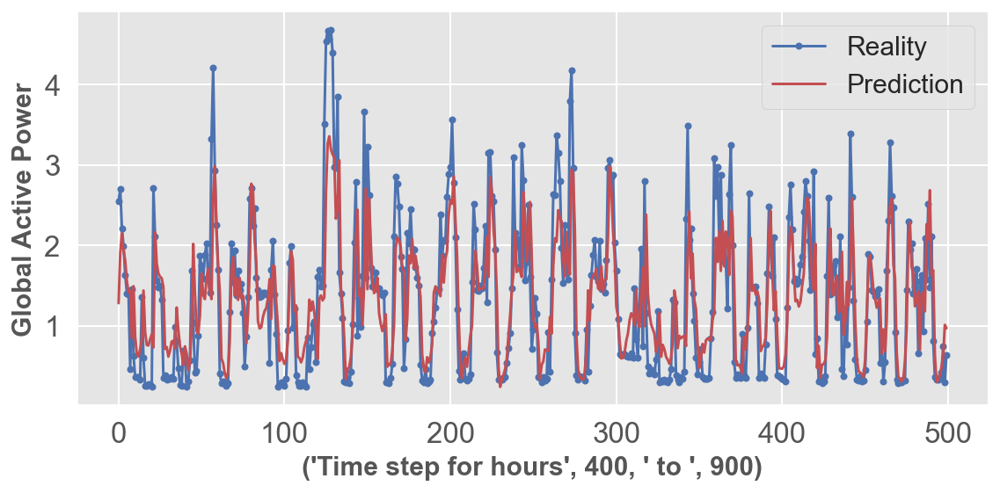

In [426]:
LSTM2.plot_graph(500, 400, 900, "Global Active Power", "hours")

# End notes 
### As previously mentioned, increasing epochs and having smaller batches would improve the model:
- More epochs will be better if the model is still improving and requires more improvement. Once we reach a plataeu of improvement then more epochs won't help.
- Smaller batch sizes causes more frequent model updates to the parameters (making the overall model more accurate)

### Key Results
- Power from our data is very seasonally guided
- Decreasing Active power consumption over time
- Decreasing Unmeasured power consumption. (Due to better efficiency?)

I learned a lot about time series from this project, but there's still lots to learn!
Possible improvements:
- Fourier Fast transform as another way to forecast.
- Hybrid Models to see if we can learn from the residuals.
- Get data from other datasets to confer if data is valid to make sure our data analysis is useful.